In [1]:
import os
import shutil
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from tqdm import tqdm
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'

In [2]:
import sys
print("Python version:", sys.version)

Python version: 3.10.14 | packaged by conda-forge | (main, Mar 20 2024, 12:45:18) [GCC 12.3.0]


# Data Prep for Task 2

In [3]:
def ensure_dir(directory):
    """Ensure output directory exists for saving images and masks,if not create it."""
    if not os.path.exists(directory):
        os.makedirs(directory)

In [4]:
def prepare_output_dirs(output_dir):
    """Create and return output directories for images and masks."""
    output_images_dir = os.path.join(output_dir, 'images')
    output_masks_dir = os.path.join(output_dir, 'masks')

    # Ensure output directories exist
    ensure_dir(output_images_dir)
    ensure_dir(output_masks_dir)

    return output_images_dir, output_masks_dir

In [5]:
def process_subjects(input_dir, output_dir, category):
    """Process subject folders, rename files, and copy to output directory."""
    # Sort subject folders for consistent processing order
    subject_folders = sorted(os.listdir(input_dir))
    
    print("--------------------------------------------------")
    print(f"Starting processing for category: {category}")
    # print("--------------------------------------------------")
    
    for subject_folder in subject_folders:
        subject_path = os.path.join(input_dir, subject_folder)
        if not os.path.isdir(subject_path):
            continue

        subject_id = subject_folder.split('_')[-1]  # Extract ID, e.g., "0" from "Subject_0"
        print("--------------------------------------------------")
        print(f"Processing Subject: {subject_folder} (ID: {subject_id}) - Category: {category}")
        print("--------------------------------------------------")

        # Get all files in the subject folder and sort them for consistency
        file_list = sorted([file_name for file_name in os.listdir(subject_path) if os.path.isfile(os.path.join(subject_path, file_name))])
        print(f"Number of files in {subject_folder} ({category}): {len(file_list)}")

        for file_name in file_list:
            file_path = os.path.join(subject_path, file_name)

            # Rename the file to subjectid_imagenumber
            new_file_name = f"{subject_id}_{file_name}"
            output_path = os.path.join(output_dir, new_file_name)

            # Copy file to output directory
            shutil.copy(file_path, output_path)
            print(f"Saved: {output_path}")

    print("--------------------------------------------------")
    print(f"Finished processing for category: {category}")
    print("--------------------------------------------------")

In [6]:
def process_folder(data_dir, output_dir):
    """Flatten folder structure, rename files, and save paths."""
    print("==================================================")
    print(f"Processing folder: {data_dir}")
    # print("==================================================")

    # Prepare output directories
    output_images_dir, output_masks_dir = prepare_output_dirs(output_dir)

    for category in ['images', 'masks']:
        input_dir = os.path.join(data_dir, category)
        output_category_dir = output_images_dir if category == 'images' else output_masks_dir

        # Process subjects in the input directory
        process_subjects(input_dir, output_category_dir, category)

    print("==================================================")
    print(f"Finished processing folder: {data_dir}")
    print("==================================================")

In [7]:
def main():
    base_dir = "/kaggle/input/computer-vision-project"  
    output_dir = "/kaggle/working/"  

    # Process train and validation folders
    for folder in ['train', 'val']:
        data_dir = os.path.join(base_dir, folder)
        output_folder = os.path.join(output_dir, folder)
        process_folder(data_dir, output_folder)
main()

Processing folder: /kaggle/input/computer-vision-project/train
--------------------------------------------------
Starting processing for category: images
--------------------------------------------------
Processing Subject: Subject_0 (ID: 0) - Category: images
--------------------------------------------------
Number of files in Subject_0 (images): 75
Saved: /kaggle/working/train/images/0_0.png
Saved: /kaggle/working/train/images/0_1.png
Saved: /kaggle/working/train/images/0_10.png
Saved: /kaggle/working/train/images/0_100.png
Saved: /kaggle/working/train/images/0_101.png
Saved: /kaggle/working/train/images/0_304.png
Saved: /kaggle/working/train/images/0_305.png
Saved: /kaggle/working/train/images/0_306.png
Saved: /kaggle/working/train/images/0_307.png
Saved: /kaggle/working/train/images/0_308.png
Saved: /kaggle/working/train/images/0_309.png
Saved: /kaggle/working/train/images/0_310.png
Saved: /kaggle/working/train/images/0_311.png
Saved: /kaggle/working/train/images/0_312.png
Saved

---------

## **Helper Functions**

In [8]:
def visualize(img,mask,pred_mask=None):
    
    if isinstance(img, torch.Tensor):
        img = img.cpu().numpy()
    if isinstance(mask, torch.Tensor):
        mask = mask.cpu().numpy()

    if isinstance(pred_mask, torch.Tensor):
        pred_mask = pred_mask.cpu().numpy()

    if img.ndim == 3 and img.shape[0] == 1:  # Channels-first format (grayscale)
        img = img.squeeze(0)  # Remove the channel dimension
    if mask.ndim == 3 and mask.shape[0] == 1:  # Channels-first format (grayscale)
        mask = mask.squeeze(0)  # Remove the channel dimension
    if pred_mask is not None:
        if pred_mask.ndim == 3 and pred_mask.shape[0] == 1:  # Channels-first format (grayscale)
            pred_mask = pred_mask.squeeze(0)
    
    plt.figure(figsize=(15, 5))
    
    # Input Image
    plt.subplot(1, 5, 1)
    plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
    plt.title("Input Image")
    plt.axis("off")
    
    # Ground Truth Mask
    plt.subplot(1, 5, 2)
    plt.imshow(mask, cmap="gray")
    plt.title("Ground Truth Mask")
    plt.axis("off")

    plt.subplot(1, 5, 3)
    plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
    plt.imshow(mask, cmap="gray", alpha=0.8)  # 'jet' for color mask and transparency with alpha
    plt.title("Input Image Ground Truth Mask")
    plt.axis("off")

    if pred_mask is not None:
        plt.subplot(1, 5, 4)
        plt.imshow(pred_mask, cmap="gray")
        plt.title("Predicted Mask")
        plt.axis("off")

        plt.subplot(1, 5, 5)
        plt.imshow(img, cmap="gray" if img.ndim == 2 else None)
        plt.imshow(pred_mask, cmap="gray", alpha=0.8)  # 'jet' for color mask and transparency with alpha
        plt.title("Input Image with Predicted Mask")
        plt.axis("off")
    
    plt.tight_layout()
    plt.show()

## **Configurations**

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Used device {device}")
torch.manual_seed(1337)
if torch.cuda.is_available():
    torch.cuda.manual_seed(1337)
torch.set_float32_matmul_precision('highest')
torch.cuda.empty_cache()
batch_size = 4

Used device cuda


## **Dataset and Data Loader**

In [10]:
class SegmentationDataset(Dataset):
    def __init__(self,images_dir,masks_dir,transform=None):
        
        self.image_paths = sorted([os.path.join(images_dir, f) for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))])
        self.mask_paths = sorted([os.path.join(masks_dir, f) for f in os.listdir(masks_dir) if os.path.isfile(os.path.join(masks_dir, f))])
        assert len(self.image_paths) == len(self.mask_paths), "Number of images and masks must be the same!"
        
        self.transform = transform
    
    def __len__(self):
        """Return the total number of samples."""
        return len(self.image_paths)
        
    def __getitem__(self, idx):
        """Return an image and its corresponding mask."""
        
        image_path = self.image_paths[idx]
        mask_path = self.mask_paths[idx]

        image = Image.open(image_path)
        mask = Image.open(mask_path)   

        # Apply transformations if provided
        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)
        
        return image, mask

Total samples in the train dataset: 1832
Total samples in the val dataset: 98
Batch image shape: torch.Size([4, 1, 256, 256]), Batch mask shape: torch.Size([4, 1, 256, 256])
tensor(1.)
tensor(1.)


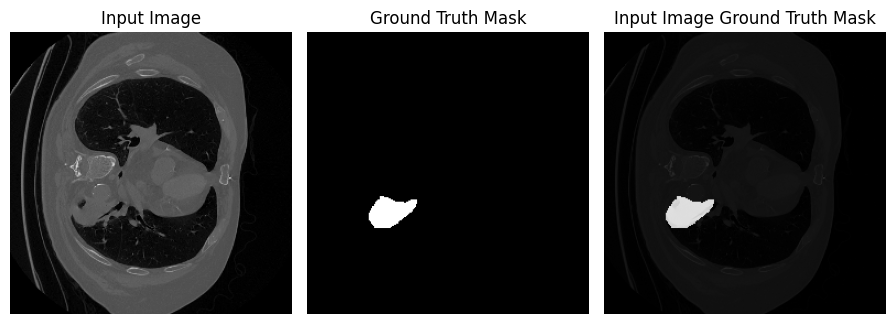

In [11]:
train_images_dir = '/kaggle/working/train/images'
train_masks_dir = '/kaggle/working/train/masks'

val_images_dir = '/kaggle/working/val/images'
val_masks_dir = '/kaggle/working/val/masks'

transform = transforms.Compose([
    # transforms.Resize((256, 256)),  # Resize both images and masks
    transforms.ToTensor(),         # Convert to PyTorch tensor
])

train_dataset = SegmentationDataset(train_images_dir, train_masks_dir,transform)
val_dataset = SegmentationDataset(val_images_dir, val_masks_dir,transform)


print(f"Total samples in the train dataset: {len(train_dataset)}")
print(f"Total samples in the val dataset: {len(val_dataset)}")


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=os.cpu_count(),pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=os.cpu_count(),pin_memory=True)

# Iterate through the DataLoader
for images, masks in train_loader:
    print(f"Batch image shape: {images.shape}, Batch mask shape: {masks.shape}")
    print(images.max())
    
    print(masks.max())
    visualize(images[2],masks[2])
    break


# for idx in range(len(train_dataset)):
#     # Get image and mask paths
#     image_path = train_dataset.image_paths[idx]
#     mask_path = train_dataset.mask_paths[idx]
    
#     print("--------------------------------------------------")
#     print(f"Index: {idx}")
#     print(f"Image path: {image_path}")
#     print(f"Mask path: {mask_path}")
#     print("--------------------------------------------------")


## **Model Building**

In [ ]:
class TwoConv(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(TwoConv, self).__init__()
        self.conv1 = nn.Conv2d(in_channels,out_channels,kernel_size=3,padding='same')
        self.dropout1 = nn.Dropout2d(0.2)
        self.batch_norm1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(out_channels,out_channels,kernel_size=3,padding='same')
        self.dropout2 = nn.Dropout2d(0.2)
        self.batch_norm2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU()

    def forward(self,x):
        x=self.conv1(x)
        x=self.dropout1(x)
        x=self.batch_norm1(x)
        x=self.relu1(x)
        x=self.conv2(x)
        x=self.dropout2(x)
        x=self.batch_norm2(x)
        x=self.relu2(x)
        return x

In [ ]:
class DownBlock(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(DownBlock, self).__init__()
        self.two_conv = TwoConv(in_channels,out_channels)
        self.down_sample = nn.MaxPool2d(kernel_size=2,stride=2)

    def forward(self,x):
        skip_connection = self.two_conv(x)
        down_out = self.down_sample(skip_connection)
        return (down_out,skip_connection)
    

In [ ]:
class UpBlock(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(UpBlock, self).__init__()
        self.up_conv = nn.ConvTranspose2d(in_channels,out_channels,kernel_size=2,stride=2)
        self.batch_norm = nn.BatchNorm2d(out_channels*2)
        self.two_conv = TwoConv(in_channels,out_channels)

    def forward(self,x,skip_connection):
        x = self.up_conv(x)
        x = torch.cat([x, skip_connection], dim=1)
        x = self.batch_norm(x)
        return self.two_conv(x)

In [ ]:
class UNet(nn.Module):
    def __init__(self,out_classes=1):
        super(UNet, self).__init__()
        # Encoder
        self.down1=DownBlock(1,64) # out 128
        self.down2=DownBlock(64,128) # out 64
        self.down3=DownBlock(128,256) # out 32
        self.down4=DownBlock(256,512) # out 16
        self.down5=DownBlock(512,1024) # out 8
        
        # BottleNeck
        self.two_conv = TwoConv(1024,2048) # out 4
        # Decoder
        self.up5 = UpBlock(2048,1024) # out 16
        self.up4 = UpBlock(1024,512) # out 32
        self.up3 = UpBlock(512,256) # out 64
        self.up2 = UpBlock(256,128) # out 128
        self.up1 = UpBlock(128,64) # out 256
        
        # Output
        self.last_conv = nn.Conv2d(64,out_classes,kernel_size=1)
        
    def forward(self,img):
        x,skip1 = self.down1(img)
        x,skip2 = self.down2(x)
        x,skip3 = self.down3(x)
        x,skip4 = self.down4(x)
        x,skip5 = self.down5(x)
        
        x = self.two_conv(x)
        
        x = self.up5(x,skip5)
        x = self.up4(x,skip4)
        x = self.up3(x,skip3)
        x = self.up2(x,skip2)
        x = self.up1(x,skip1)

        return self.last_conv(x)

In [ ]:
%%capture
!pip install torchinfo torchviz

In [ ]:
from torchinfo import summary

model = UNet(out_classes=1)
# summary(model, input_size=(1, 1, 256, 256))  # Batch size, channels, height, and width

In [ ]:
from torchviz import make_dot

model = UNet(out_classes=1)
x = torch.randn(1, 1, 256, 256)  # Example input
output = model(x)
# Create and save the visualization
dot = make_dot(output, params=dict(model.named_parameters()))
dot.render("unet_model", format="png")

In [ ]:
%%capture
!pip install -U git+https://github.com/jlcsilva/segmentation_models.pytorch

### FPN pre-trained

In [ ]:
import segmentation_models_pytorch as smp

In [ ]:
from segmentation_models_pytorch.encoders import get_encoder_names

# List of supported encoders
encoders = get_encoder_names()
for model in encoders:
    print("Supported encoders:", model)

In [ ]:
# import segmentation_models_pytorch as smp

# model = smp.Unet(
#     encoder_name="resnet34",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
#     encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
#     in_channels=1,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
#     classes=3,                      # model output channels (number of classes in your dataset)
# )

In [ ]:
ENCODER = 'resnet34'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['tumor']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multicalss segmentation
DEVICE = 'cuda'

# create segmentation model with pretrained encoder
model = smp.FPN(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    in_channels=1,
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [ ]:
loss = smp.utils.losses.DiceLoss()
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0001),
])

In [ ]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [ ]:
ENCODER = 'efficientnet-b1'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['tumor']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multicalss segmentation
DEVICE = 'cuda'

# create segmentation model with pretrained encoder
model = smp.FPN(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    in_channels=1,
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [17]:
class BCEDiceLoss(nn.Module):
    def __init__(self,epsilon=1e-6,prob_of_bce = 0.4):
        super(BCEDiceLoss,self).__init__()
        self.epsilon = epsilon
        self.bce = nn.BCEWithLogitsLoss()
        self.prob_of_bce=prob_of_bce
        
    def forward(self,y_pred,y_true):
        # # binary crossentropy loss from logits
        bce_loss = self.bce(y_pred,y_true)

        # sigmoid for diceloss
        y_pred = torch.sigmoid(y_pred)

        # Flatten
        y_pred = y_pred.view(-1)
        y_true = y_true.view(-1)
        
        # Compute Dice Loss
        intersection = (y_pred * y_true).sum()
        union = y_pred.sum() + y_true.sum()
        dice = (2. * intersection + self.epsilon) / (union + self.epsilon)
        dice_loss = 1 - dice

        # Combine Dice and BCE losses
        return (self.prob_of_bce * bce_loss) + dice_loss

In [18]:
def dice_coefficient(pred, true, epsilon=1e-07):
    pred = (torch.sigmoid(pred) > 0.5).float()
    pred = pred.view(-1)
    true = true.view(-1).float()

    intersection = abs(torch.sum(pred * true))
    union = abs(torch.sum(pred) + torch.sum(true))
    dice = (2. * intersection + epsilon) / (union + epsilon)
    
    return dice

In [19]:
def calculate_iou(pred,true):
    
    pred = (torch.sigmoid(pred) > 0.5).float()
    pred = pred.view(-1)
    true = true.view(-1).float()
    
    intersection = torch.sum(pred * true)
    union = torch.sum(pred) + torch.sum(true) - intersection
    
    iou = intersection / (union + 1e-6)  # Add a small epsilon to avoid division by zero
    return iou

In [20]:
def validate(model,loss_fn,val_loader,device,num_samples=2):
    model.eval()
    val_loss=0
    iou=0
    acc=0
    dice = 0
    with torch.no_grad():
        for img,mask in val_loader:
            img,mask = img.to(device),mask.to(device)
            pred = model(img)['out']
            loss = loss_fn(pred,mask)
            
            val_loss += loss.item()
            iou += calculate_iou(pred,mask).item()
            dice += dice_coefficient(pred,mask).item()
        for img,mask in val_loader:
            img,mask = img.to(device),mask.to(device)
            for i in range(num_samples):
                input = img[i]
                input= input.unsqueeze(0)
                pred = model(input)
                pred = pred.squeeze(0)
                pred = torch.sigmoid(pred)
                pred = (pred > 0.5).float()
                visualize(img[i],mask[i],pred)
            break
    val_loss/=len(val_loader)
    iou/=len(val_loader)
    dice/=len(val_loader)
    return val_loss,iou,dice

In [21]:
%%capture
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

### Torch Vision Models

In [ ]:
def dice_loss(pred, target, smooth=1):
    """
    Computes the Dice Loss for binary segmentation.
    Args:
        pred: Tensor of predictions (batch_size, 1, H, W).
        target: Tensor of ground truth (batch_size, 1, H, W).
        smooth: Smoothing factor to avoid division by zero.
    Returns:
        Scalar Dice Loss.
    """
    # Apply sigmoid to convert logits to probabilities
    pred = torch.sigmoid(pred)
    
    # Calculate intersection and union
    intersection = (pred * target).sum(dim=(2, 3))
    union = pred.sum(dim=(2, 3)) + target.sum(dim=(2, 3))
    
    # Compute Dice Coefficient
    dice = (2. * intersection + smooth) / (union + smooth)
    
    # Return Dice Loss
    return 1 - dice.mean()

In [ ]:
import torchvision.models as models
import torchvision
import torchvision.models.segmentation as sgm

In [ ]:
model = torchvision.models.segmentation.fcn_resnet50(pretrained=True,progress=True)
# print(model)

In [ ]:
print(model.backbone.conv1) 
model.backbone.conv1 = torch.nn.Conv2d(1, 64, kernel_size=7, stride=(2,2), padding=(3,3), bias=False)
print(model.backbone.conv1) 

In [ ]:
print(model.classifier[4])
print(model.aux_classifier[4])

model.classifier[4] = torch.nn.Conv2d(512, 2, kernel_size=(1, 1)) 
model.aux_classifier[4] = torch.nn.Conv2d(256, 2, kernel_size=(1, 1))  

print(model.classifier[4])
print(model.aux_classifier[4])

model = model.to(device) 

In [ ]:
EPOCHS = 100
lr=0.001
prob_of_bce=0.7
weight_decay = 0.0001
optimizer = torch.optim.AdamW(model.parameters(),lr=lr,fused=True,weight_decay=weight_decay)

In [ ]:
for epoch in range(EPOCHS):
    model.train()
    epoch_loss = 0  # Track epoch loss
    
    for images, masks in train_loader:
        images, masks = images.to(device), masks.to(device)
        
        optimizer.zero_grad()  # Reset gradients
        outputs = model(images)['out']  # Model output
        loss = dice_loss(outputs, masks)  # Compute Dice Loss
        loss.backward()  # Backpropagation
        optimizer.step()  # Update parameters
        
        epoch_loss += loss.item()
    
    print(f"Epoch {epoch + 1}/{EPOCHS}, Loss: {epoch_loss / len(train_loader):.4f}")

In [ ]:
def dice_coefficient(pred, target):
    pred = torch.argmax(F.softmax(pred, dim=1), dim=1)  # Get class predictions
    intersection = (pred * target).sum()
    union = pred.sum() + target.sum()
    dice = (2. * intersection) / (union + 1e-6)
    return dice.item()

model.eval()
for images, masks in val_loader:
    images, masks = images.to(device), masks.to(device)
    with torch.no_grad():
        outputs = model(images)['out']
    dice_score = dice_coefficient(outputs, masks)
    print(f"Dice Coefficient: {dice_score:.4f}")

In [ ]:
import matplotlib.pyplot as plt

def visualize_segmentation(image, prediction, ground_truth):
    """
    Visualize input image, model prediction, and ground truth mask side by side.
    Args:
        image: Tensor of shape (C, H, W), the input image.
        prediction: Tensor of shape (H, W), the model's predicted mask.
        ground_truth: Tensor of shape (H, W), the ground truth mask.
    """
    plt.figure(figsize=(12, 6))
    
    # Input image
    plt.subplot(1, 3, 1)
    plt.imshow(image.permute(1, 2, 0).cpu().numpy())  # Convert tensor to image
    plt.title("Input Image")
    plt.axis('off')
    
    # Model prediction
    plt.subplot(1, 3, 2)
    plt.imshow(prediction.cpu().numpy(), cmap='gray')  # Display as grayscale
    plt.title("Prediction")
    plt.axis('off')
    
    # Ground truth
    plt.subplot(1, 3, 3)
    plt.imshow(ground_truth.cpu().numpy(), cmap='gray')  # Display as grayscale
    plt.title("Ground Truth")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

------

In [ ]:
EPOCHS = 100
lr=0.001
prob_of_bce=0.7
weight_decay = 0.0001
model = UNet(1)
model.to(device)
optimizer = torch.optim.AdamW(model.parameters(),lr=lr,fused=True,weight_decay=weight_decay)
# loss_fn = smp.losses.FocalLoss(mode='binary')
loss_fn = BCEDiceLoss(prob_of_bce=prob_of_bce)

In [ ]:
model_dir = 'model'
log_dir = 'log'
os.makedirs(log_dir,exist_ok=True)
os.makedirs(model_dir, exist_ok=True)
log_file = os.path.join(log_dir,f'log.txt')
with open(log_file,'w') as f:
    f.write(f"Epochs {EPOCHS} | learning_rate {lr} | weight_decay {weight_decay} | Dropout {0.2} | Prob Of BCE Loss {prob_of_bce}| optimizer {optimizer.__class__.__name__}| loss function {loss_fn.__class__.__name__}|batch size {batch_size}\n")

In [ ]:
total_train_loss = []
total_val_loss = []
best_iou = 0

for epoch in range(EPOCHS):    
    model.train()
    epoch_loss = 0
    for img , mask in tqdm(train_loader,desc=f'Epoch {epoch+1}/{EPOCHS}'):
        
        optimizer.zero_grad()
        img , mask = img.to(device) , mask.to(device)
        
        pred = model(img)
        
        loss = loss_fn(pred,mask)
        
        loss.backward()
        
        norm = nn.utils.clip_grad_norm_(model.parameters(),1.0)
        
        optimizer.step()
        
        epoch_loss += loss.item()
    
    epoch_loss/=len(train_loader)
    val_loss,iou,dice = validate(model,loss_fn,val_loader,device)
    if iou > best_iou:
        print(f'Achieved Better IOU with {iou}, Than {best_iou}')
        best_iou = iou
        torch.save(model.state_dict(), os.path.join(model_dir,"UNet_weights.pth"))
        
    total_train_loss.append(epoch_loss)
    total_val_loss.append(val_loss)
    
    print(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}")
    with open(log_file,'a') as f:
            f.write(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}\n")  

In [ ]:
plt.figure(figsize=(10, 6))
epochs = range(1, len(total_train_loss) + 1)

# Plot training and validation loss
plt.plot(epochs, total_train_loss, label='Training Loss', marker='o', linestyle='-')
plt.plot(epochs, total_val_loss, label='Validation Loss', marker='o', linestyle='--')

# Add titles and labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.savefig("loss_plot.png")

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:

all_models = dir(sgm)

for model in all_models:
    print(model)

In [12]:
def dice_loss(pred, target, smooth=1):
    """
    Computes the Dice Loss for binary segmentation.
    Args:
        pred: Tensor of predictions (batch_size, 1, H, W).
        target: Tensor of ground truth (batch_size, 1, H, W).
        smooth: Smoothing factor to avoid division by zero.
    Returns:
        Scalar Dice Loss.
    """
    # Apply sigmoid to convert logits to probabilities
    pred = torch.sigmoid(pred)
    
    # Calculate intersection and union
    intersection = (pred * target).sum(dim=(2, 3))
    union = pred.sum(dim=(2, 3)) + target.sum(dim=(2, 3))
    
    # Compute Dice Coefficient
    dice = (2. * intersection + smooth) / (union + smooth)
    
    # Return Dice Loss
    return 1 - dice.mean()

In [22]:
import torchvision.models as models
import torchvision
import torchvision.models.segmentation as sgm

In [23]:
model = torchvision.models.segmentation.fcn_resnet50(pretrained=True,progress=True)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FCN_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [24]:
print(model.backbone.conv1) 
model.backbone.conv1 = torch.nn.Conv2d(1, 64, kernel_size=7, stride=(2,2), padding=(3,3), bias=False)
print(model.backbone.conv1) 


print(model.classifier[4])
print(model.aux_classifier[4])

model.classifier[4] = torch.nn.Conv2d(512, 1, kernel_size=(1, 1)) 
model.aux_classifier[4] = torch.nn.Conv2d(256, 1, kernel_size=(1, 1))  

print(model.classifier[4])
print(model.aux_classifier[4])

model = model.to(device) 

Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
Conv2d(512, 21, kernel_size=(1, 1), stride=(1, 1))
Conv2d(256, 21, kernel_size=(1, 1), stride=(1, 1))
Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
Conv2d(256, 1, kernel_size=(1, 1), stride=(1, 1))


In [25]:
EPOCHS = 100
lr=0.001
prob_of_bce=0.7
weight_decay = 0.0001
# model = UNet(1)
# model.to(device)
optimizer = torch.optim.AdamW(model.parameters(),lr=lr,fused=True,weight_decay=weight_decay)

# loss_fn = smp.losses.FocalLoss(mode='binary')
loss_fn = BCEDiceLoss(prob_of_bce=prob_of_bce)

In [26]:
model_dir = 'model'
log_dir = 'log'
os.makedirs(log_dir,exist_ok=True)
os.makedirs(model_dir, exist_ok=True)
log_file = os.path.join(log_dir,f'log.txt')
with open(log_file,'w') as f:
    f.write(f"Epochs {EPOCHS} | learning_rate {lr} | weight_decay {weight_decay} | Dropout {0.2} | Prob Of BCE Loss {prob_of_bce}| optimizer {optimizer.__class__.__name__}| loss function {loss_fn.__class__.__name__}|batch size {batch_size}\n")

Epoch 1/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


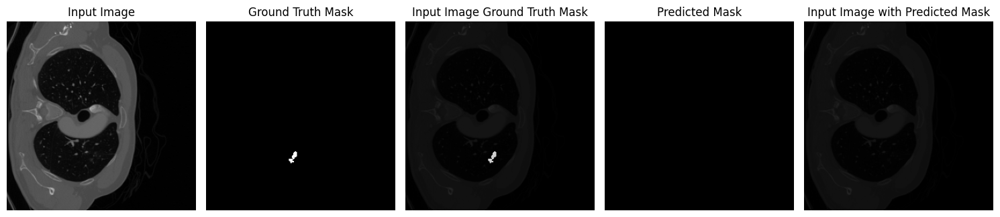

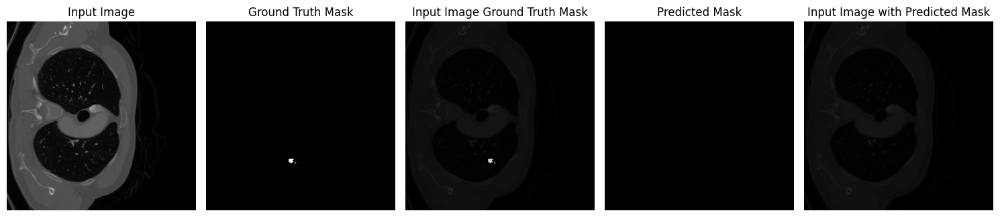

Epoch 1| Train_loss: 0.7646| Validate_loss: 1.0089| Val IOU: 0.0000| Val Best IOU 0.0000| Val Dice Coefficient 0.0000


Epoch 2/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


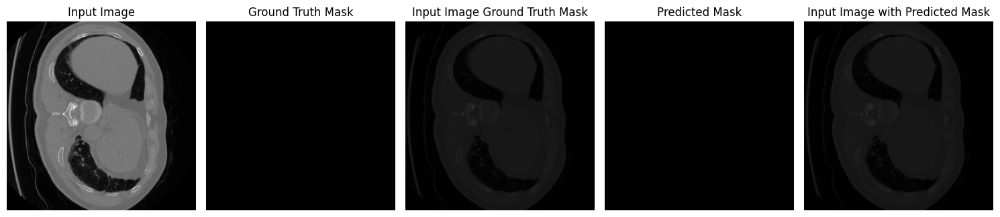

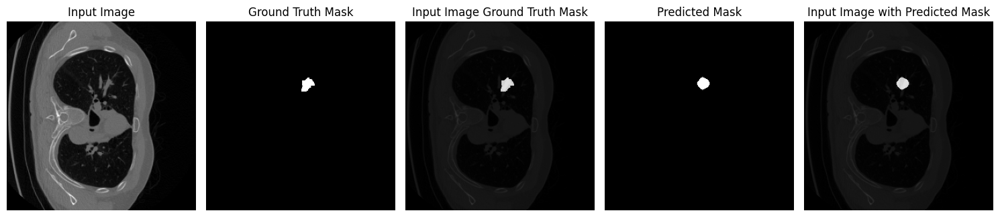

Achieved Better IOU with 0.19777508795261384, Than 0
Epoch 2| Train_loss: 0.5396| Validate_loss: 0.7319| Val IOU: 0.1978| Val Best IOU 0.1978| Val Dice Coefficient 0.2804


Epoch 3/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


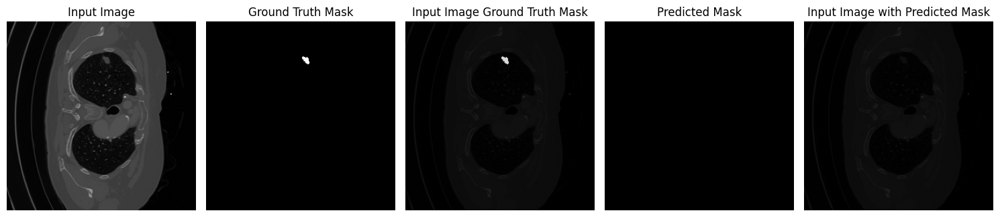

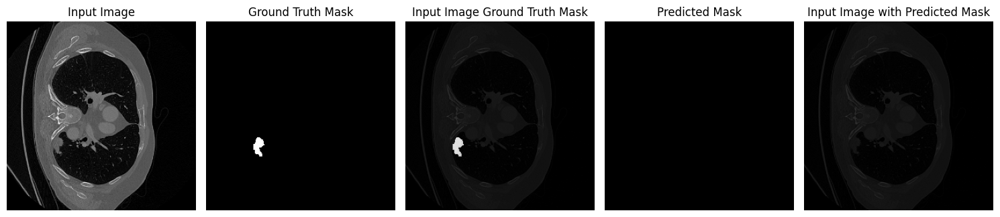

Achieved Better IOU with 0.20409785509109496, Than 0.19777508795261384
Epoch 3| Train_loss: 0.3994| Validate_loss: 0.7377| Val IOU: 0.2041| Val Best IOU 0.2041| Val Dice Coefficient 0.2739


Epoch 4/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


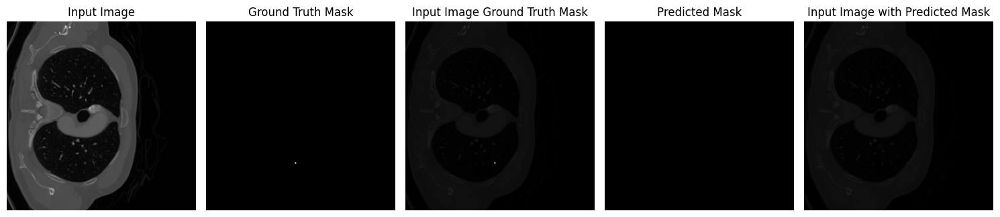

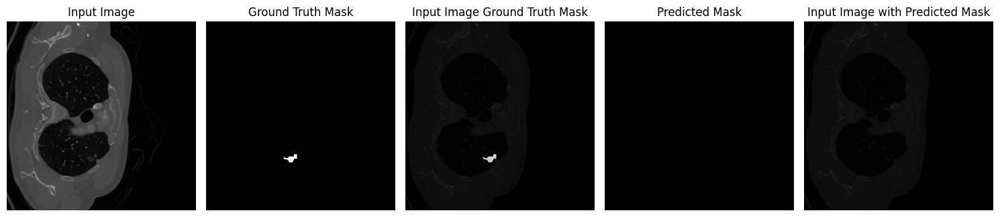

Achieved Better IOU with 0.26591252818703653, Than 0.20409785509109496
Epoch 4| Train_loss: 0.3346| Validate_loss: 0.6539| Val IOU: 0.2659| Val Best IOU 0.2659| Val Dice Coefficient 0.3658


Epoch 5/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


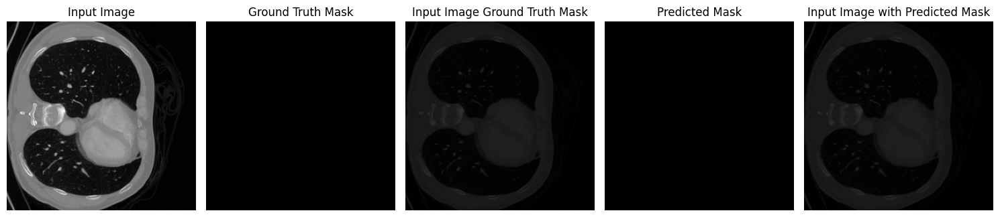

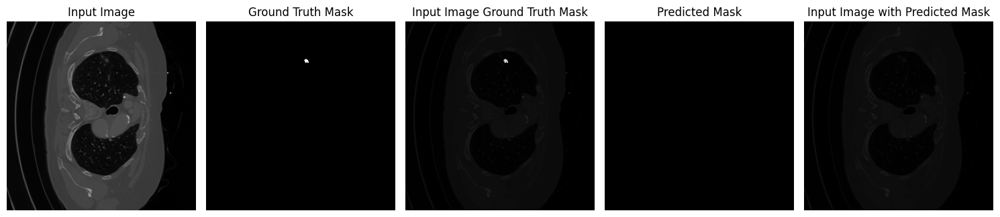

Achieved Better IOU with 0.37461421370506287, Than 0.26591252818703653
Epoch 5| Train_loss: 0.2981| Validate_loss: 0.5124| Val IOU: 0.3746| Val Best IOU 0.3746| Val Dice Coefficient 0.5069


Epoch 6/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


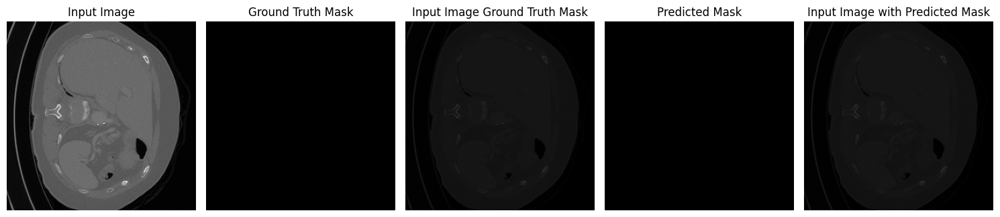

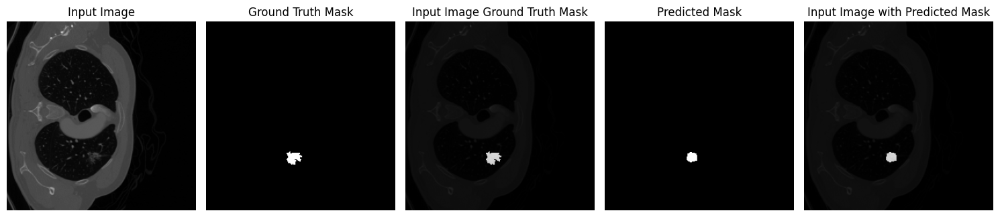

Epoch 6| Train_loss: 0.2619| Validate_loss: 0.5803| Val IOU: 0.3170| Val Best IOU 0.3746| Val Dice Coefficient 0.4317


Epoch 7/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


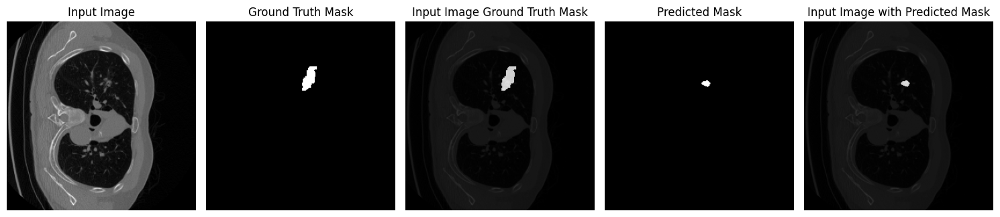

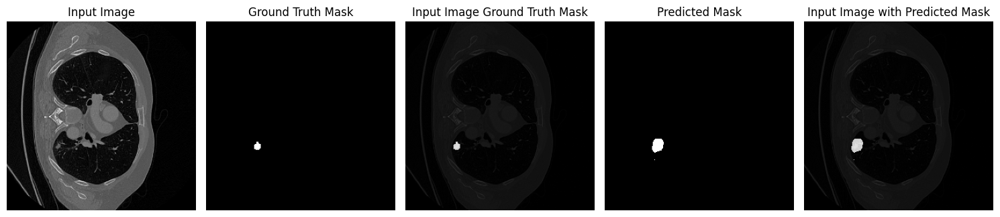

Achieved Better IOU with 0.3763714478164911, Than 0.37461421370506287
Epoch 7| Train_loss: 0.2372| Validate_loss: 0.4999| Val IOU: 0.3764| Val Best IOU 0.3764| Val Dice Coefficient 0.5121


Epoch 8/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


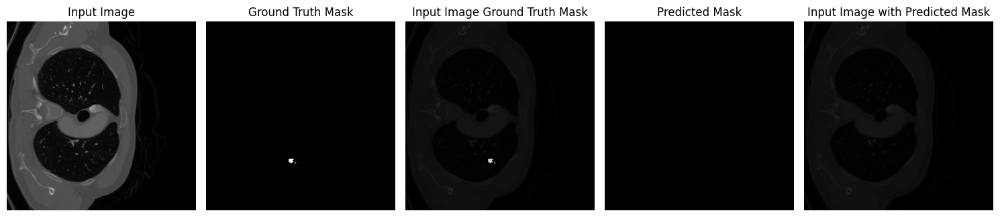

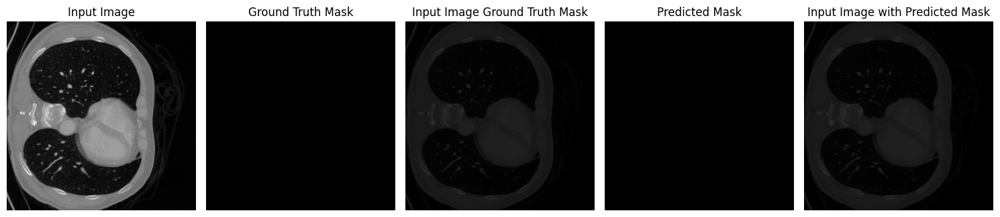

Epoch 8| Train_loss: 0.2118| Validate_loss: 0.5466| Val IOU: 0.3264| Val Best IOU 0.3764| Val Dice Coefficient 0.4561


Epoch 9/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


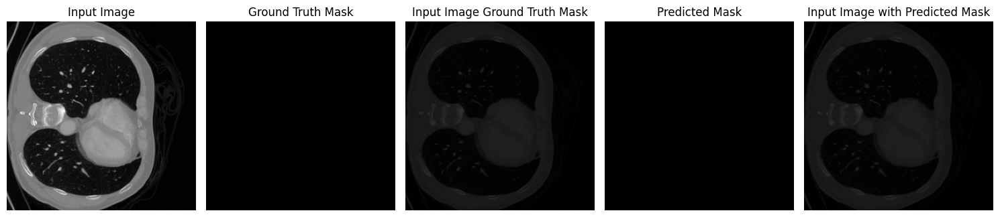

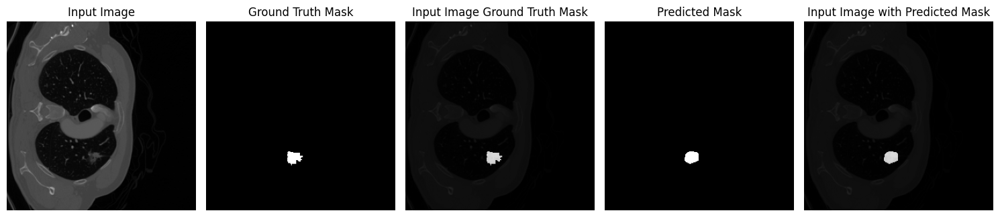

Achieved Better IOU with 0.5208660763502121, Than 0.3763714478164911
Epoch 9| Train_loss: 0.2118| Validate_loss: 0.3451| Val IOU: 0.5209| Val Best IOU 0.5209| Val Dice Coefficient 0.6686


Epoch 10/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


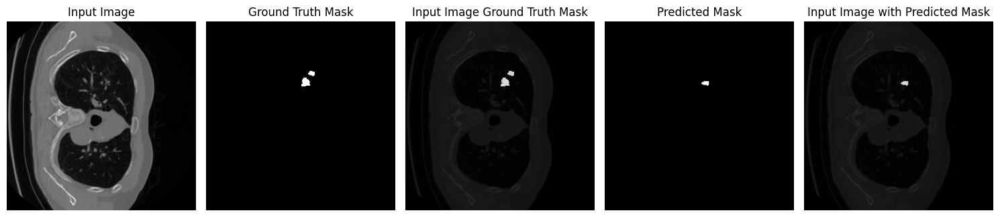

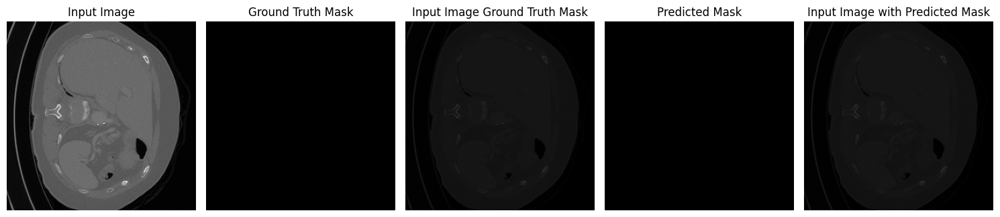

Epoch 10| Train_loss: 0.2017| Validate_loss: 0.5134| Val IOU: 0.3634| Val Best IOU 0.5209| Val Dice Coefficient 0.4939


Epoch 11/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


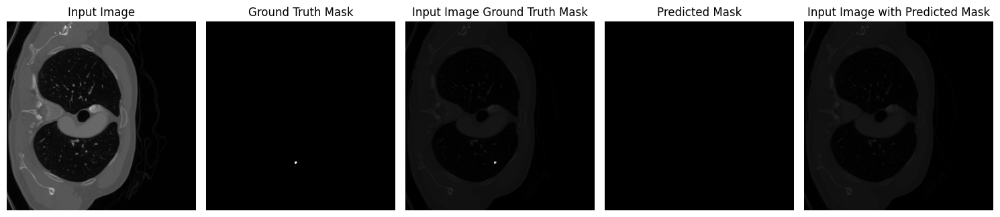

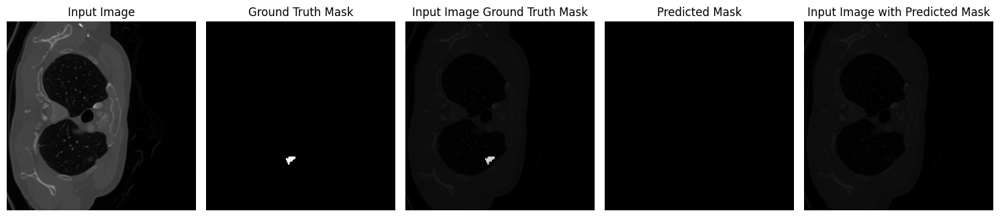

Epoch 11| Train_loss: 0.1862| Validate_loss: 0.4282| Val IOU: 0.4505| Val Best IOU 0.5209| Val Dice Coefficient 0.5844


Epoch 12/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


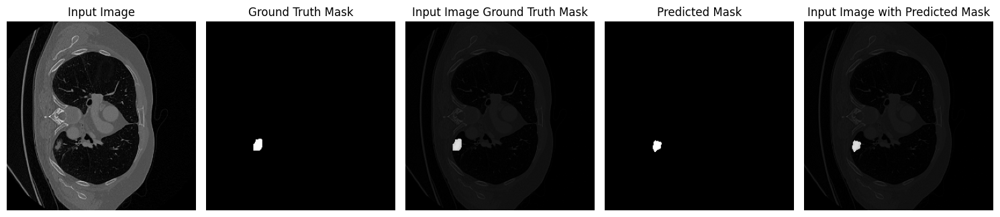

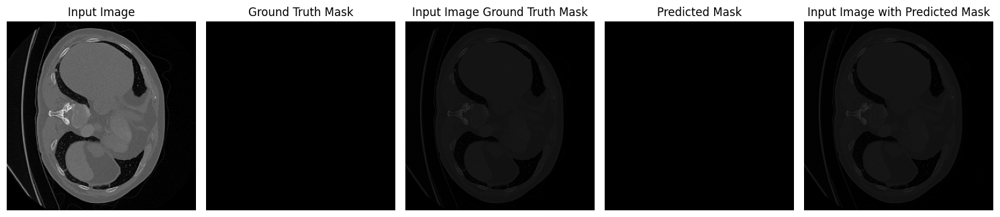

Epoch 12| Train_loss: 0.1804| Validate_loss: 0.5994| Val IOU: 0.2717| Val Best IOU 0.5209| Val Dice Coefficient 0.4037


Epoch 13/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


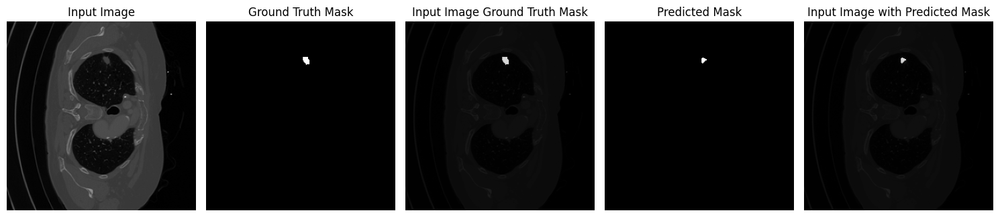

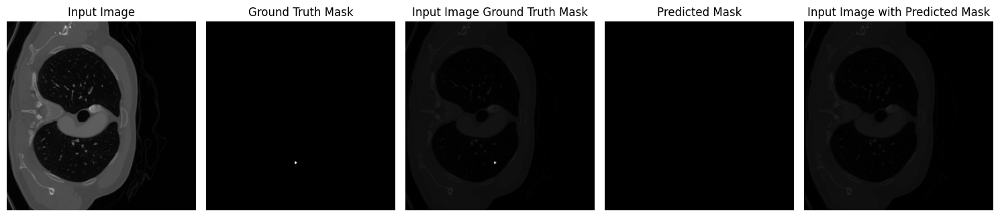

Epoch 13| Train_loss: 0.1646| Validate_loss: 0.5149| Val IOU: 0.3515| Val Best IOU 0.5209| Val Dice Coefficient 0.4944


Epoch 14/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


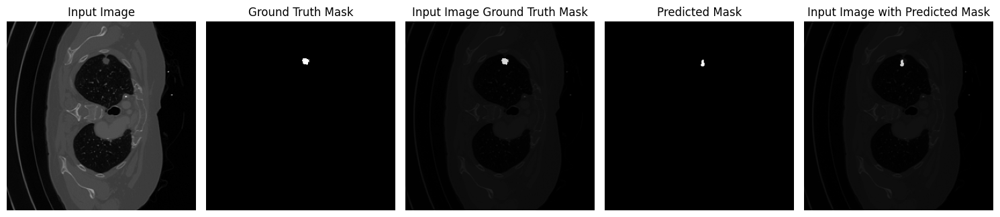

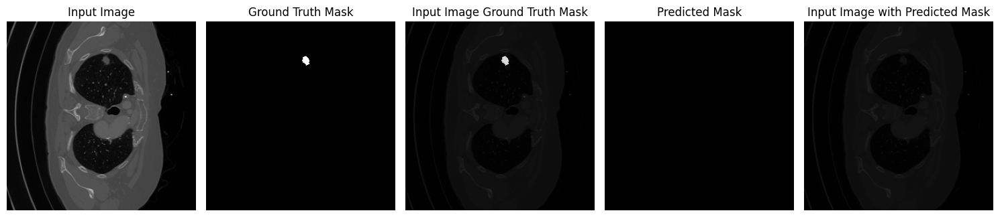

Epoch 14| Train_loss: 0.1655| Validate_loss: 0.5590| Val IOU: 0.3279| Val Best IOU 0.5209| Val Dice Coefficient 0.4485


Epoch 15/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


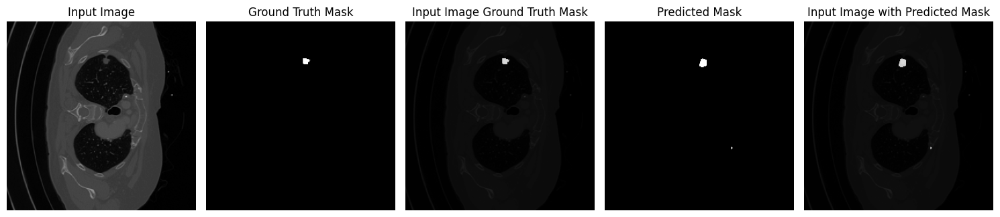

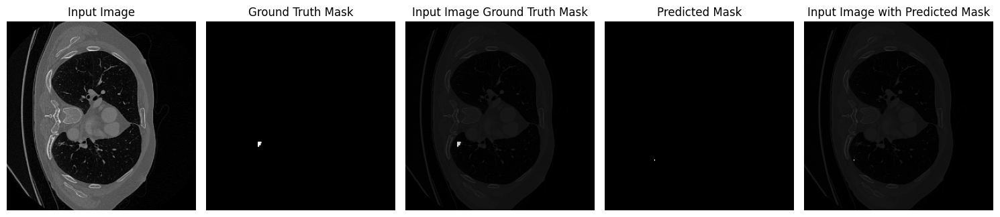

Epoch 15| Train_loss: 0.1601| Validate_loss: 0.4301| Val IOU: 0.4379| Val Best IOU 0.5209| Val Dice Coefficient 0.5787


Epoch 16/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


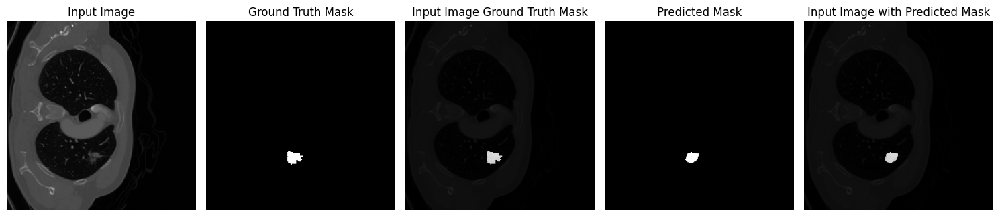

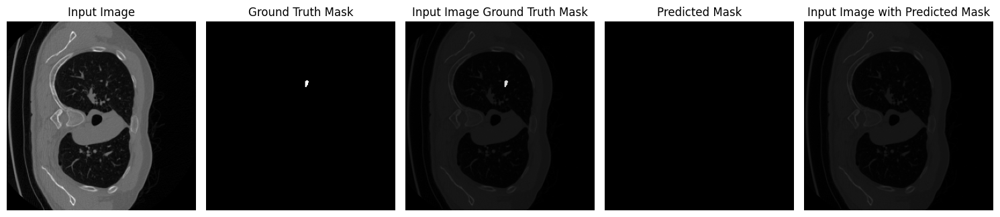

Epoch 16| Train_loss: 0.1586| Validate_loss: 0.5197| Val IOU: 0.3563| Val Best IOU 0.5209| Val Dice Coefficient 0.4913


Epoch 17/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


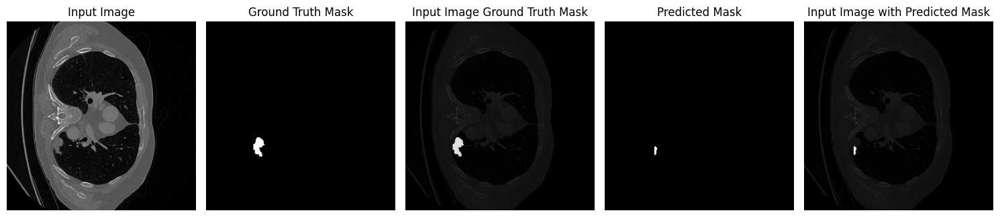

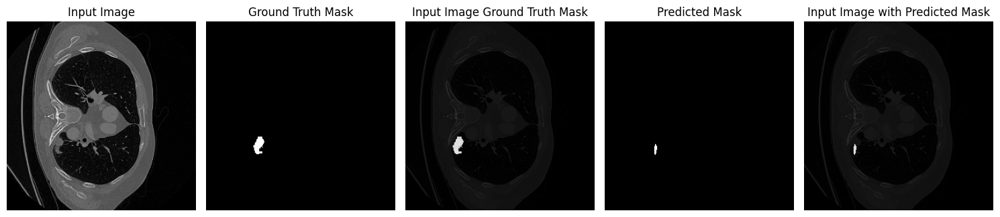

Epoch 17| Train_loss: 0.1424| Validate_loss: 0.4822| Val IOU: 0.3925| Val Best IOU 0.5209| Val Dice Coefficient 0.5267


Epoch 18/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


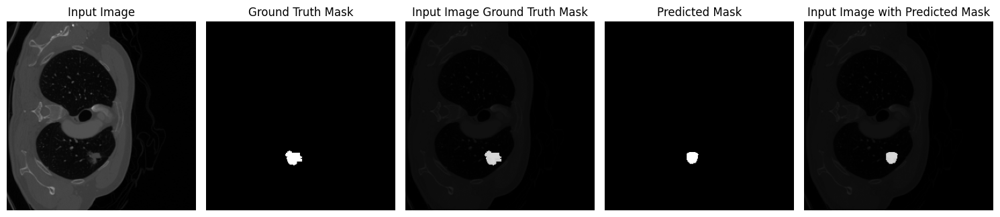

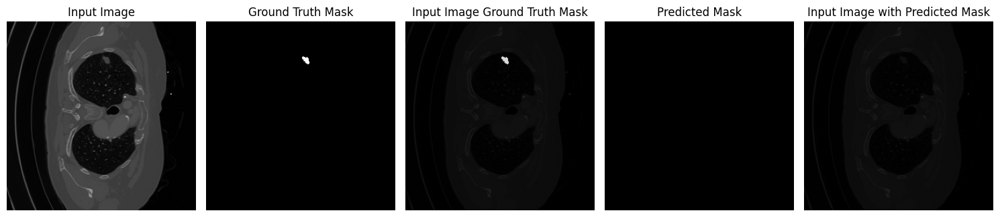

Epoch 18| Train_loss: 0.1400| Validate_loss: 0.5630| Val IOU: 0.3166| Val Best IOU 0.5209| Val Dice Coefficient 0.4870


Epoch 19/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


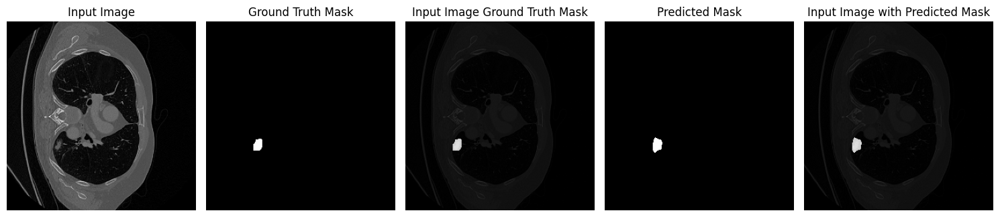

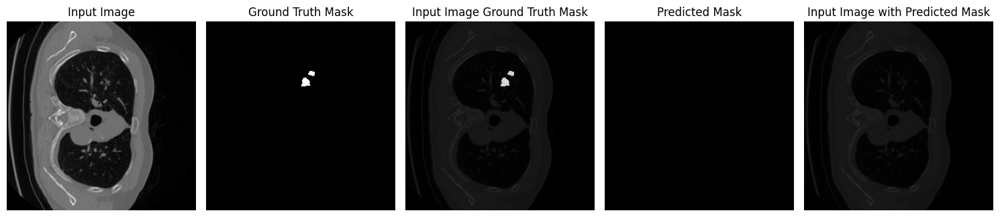

Epoch 19| Train_loss: 0.1431| Validate_loss: 0.4219| Val IOU: 0.4401| Val Best IOU 0.5209| Val Dice Coefficient 0.5874


Epoch 20/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


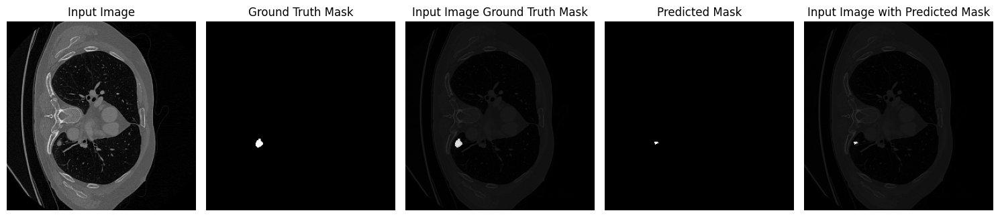

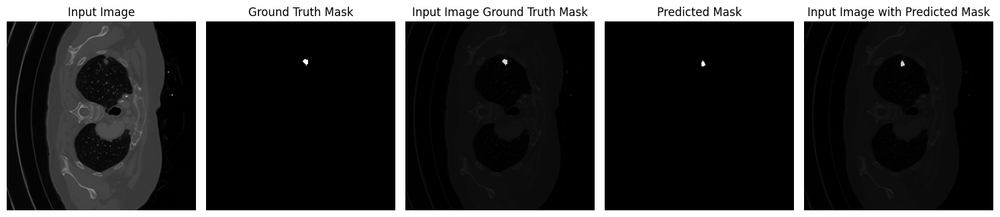

Epoch 20| Train_loss: 0.1372| Validate_loss: 0.5081| Val IOU: 0.3608| Val Best IOU 0.5209| Val Dice Coefficient 0.5023


Epoch 21/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


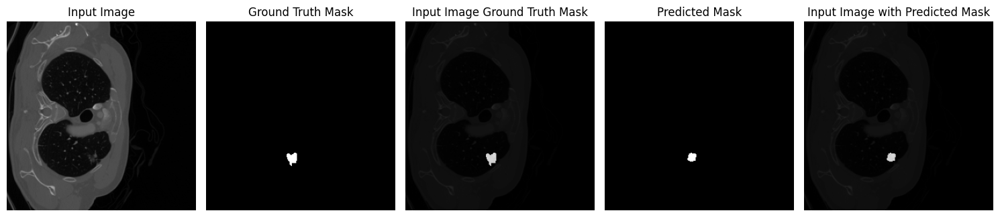

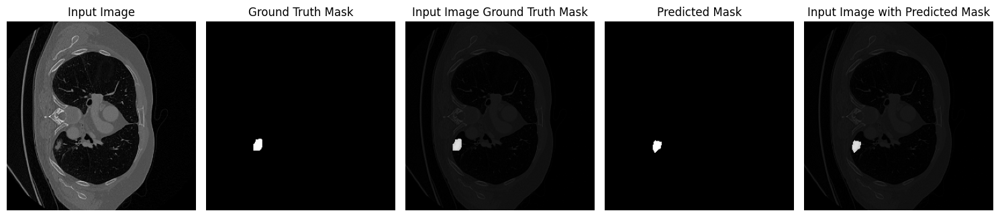

Epoch 21| Train_loss: 0.1417| Validate_loss: 0.5503| Val IOU: 0.3276| Val Best IOU 0.5209| Val Dice Coefficient 0.4605


Epoch 22/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


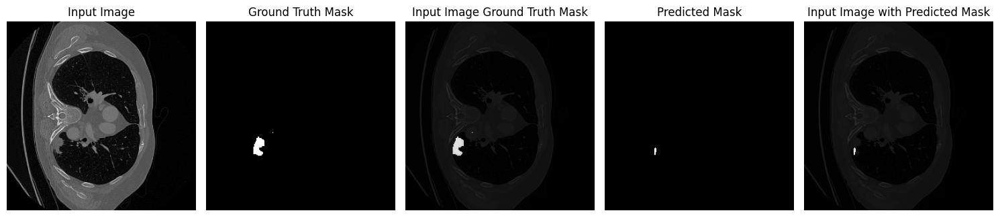

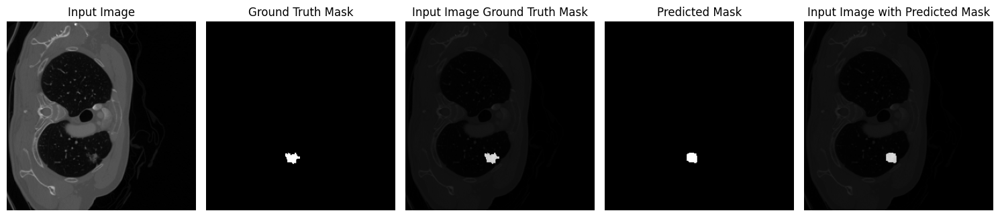

Epoch 22| Train_loss: 0.1381| Validate_loss: 0.4922| Val IOU: 0.3811| Val Best IOU 0.5209| Val Dice Coefficient 0.5178


Epoch 23/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


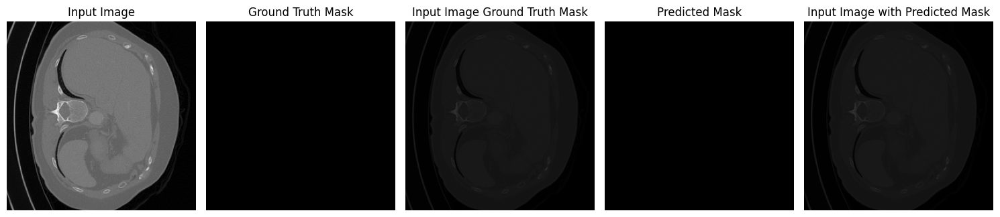

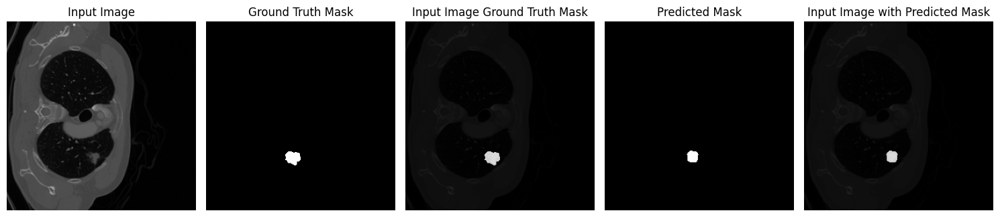

Epoch 23| Train_loss: 0.1366| Validate_loss: 0.5103| Val IOU: 0.3602| Val Best IOU 0.5209| Val Dice Coefficient 0.4971


Epoch 24/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


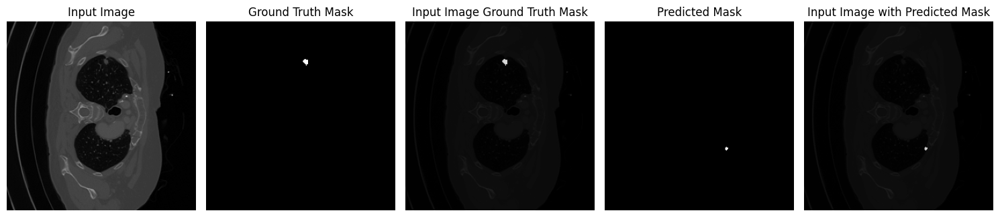

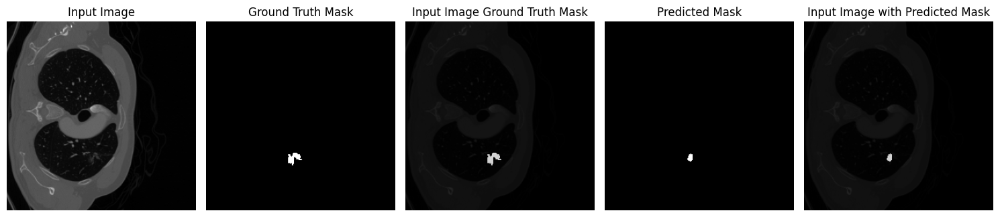

Epoch 24| Train_loss: 0.1361| Validate_loss: 0.4777| Val IOU: 0.3888| Val Best IOU 0.5209| Val Dice Coefficient 0.5730


Epoch 25/100:  22%|██▏       | 103/458 [00:14<00:48,  7.36it/s]

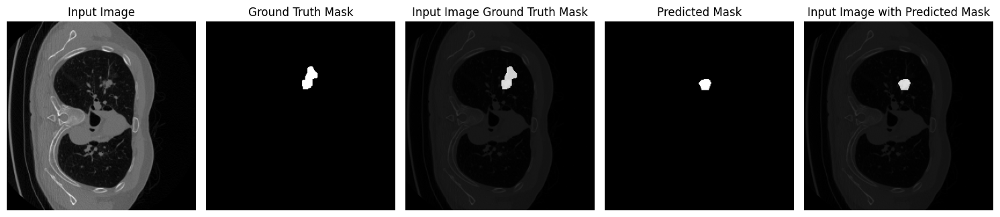

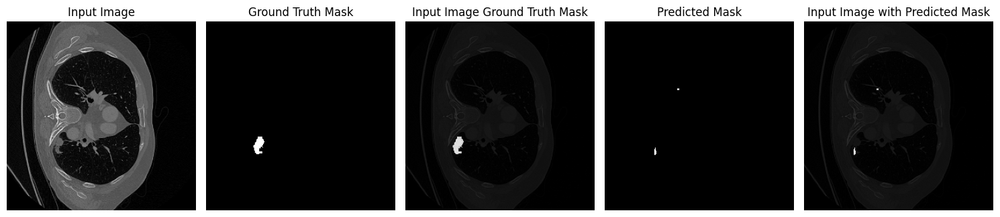

Epoch 26| Train_loss: 0.1289| Validate_loss: 0.6154| Val IOU: 0.2888| Val Best IOU 0.5209| Val Dice Coefficient 0.3998


Epoch 27/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


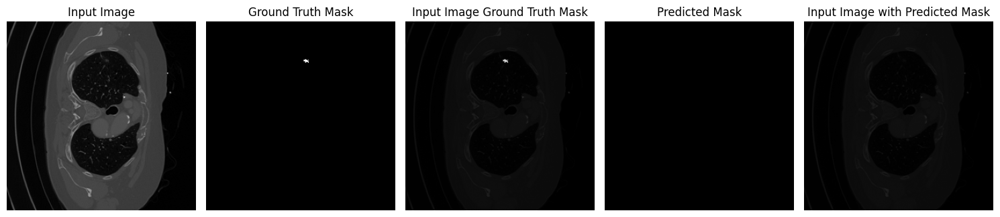

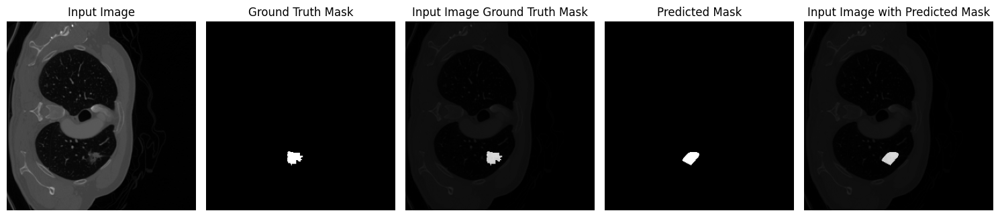

Epoch 27| Train_loss: 0.1270| Validate_loss: 0.5207| Val IOU: 0.3516| Val Best IOU 0.5209| Val Dice Coefficient 0.4883


Epoch 28/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


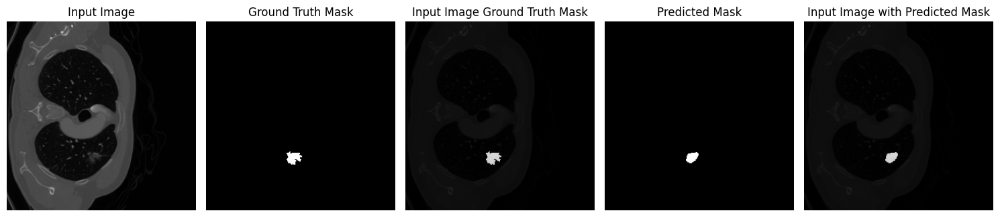

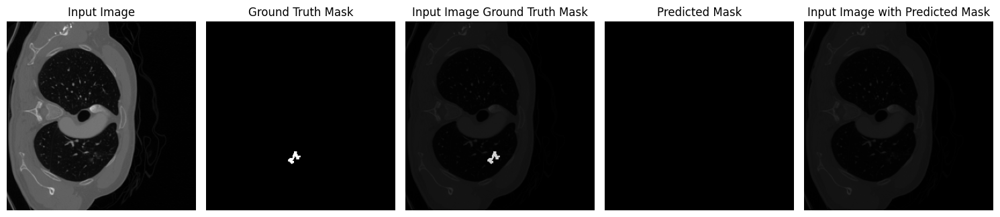

Epoch 28| Train_loss: 0.1257| Validate_loss: 0.4354| Val IOU: 0.4261| Val Best IOU 0.5209| Val Dice Coefficient 0.5749


Epoch 29/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


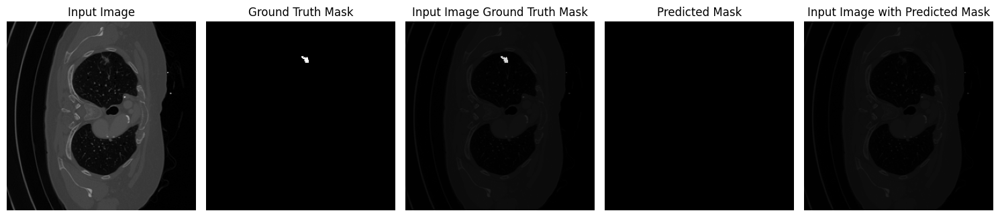

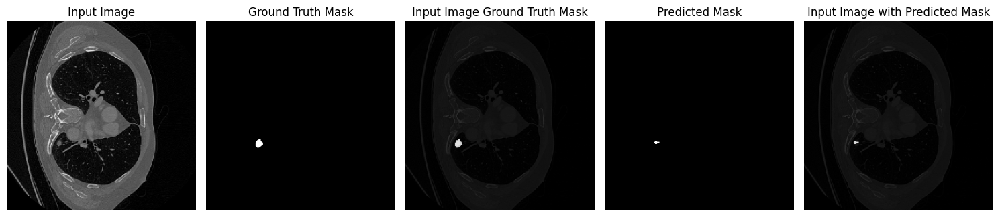

Epoch 29| Train_loss: 0.1291| Validate_loss: 0.5499| Val IOU: 0.3363| Val Best IOU 0.5209| Val Dice Coefficient 0.4600


Epoch 30/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


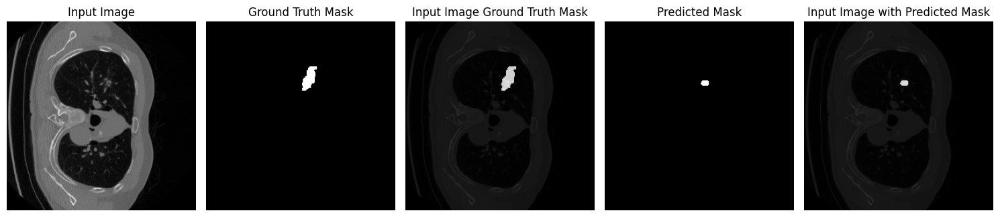

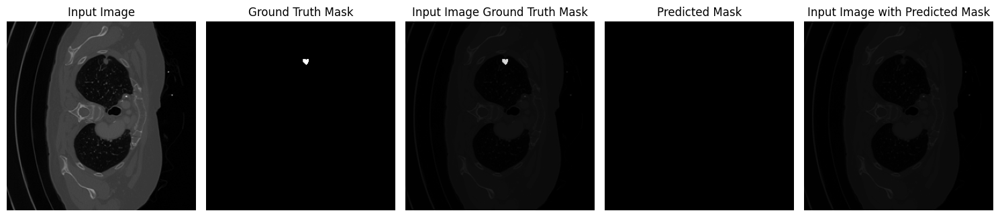

Epoch 30| Train_loss: 0.1229| Validate_loss: 0.5149| Val IOU: 0.3493| Val Best IOU 0.5209| Val Dice Coefficient 0.4949


Epoch 31/100: 100%|██████████| 458/458 [01:02<00:00,  7.27it/s]


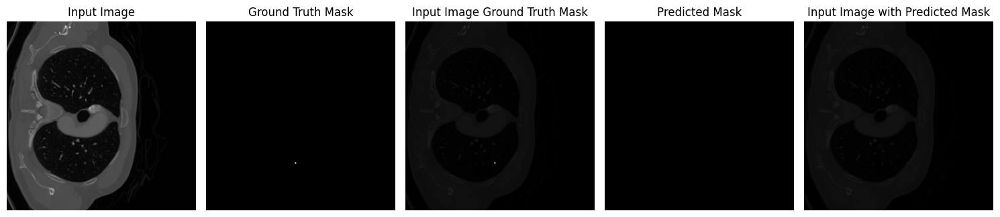

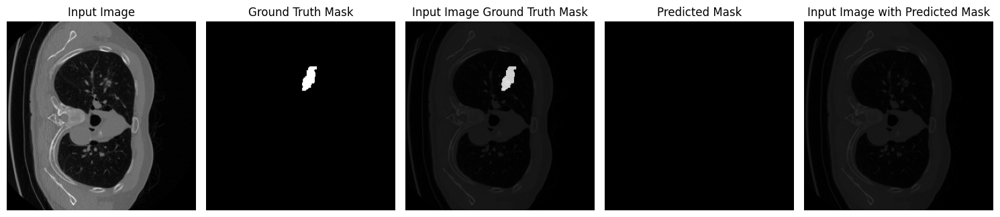

Epoch 31| Train_loss: 0.1152| Validate_loss: 0.4972| Val IOU: 0.3707| Val Best IOU 0.5209| Val Dice Coefficient 0.5120


Epoch 32/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


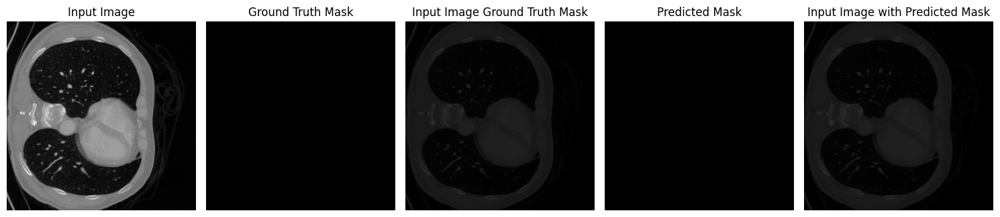

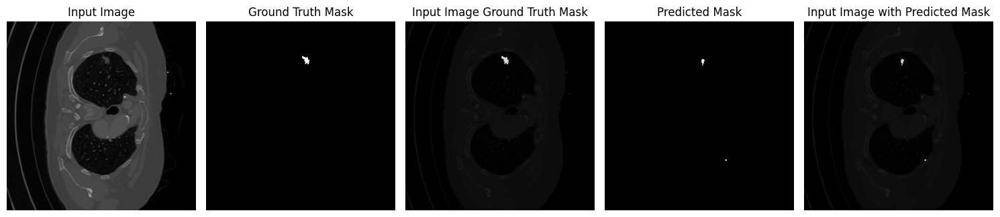

Epoch 32| Train_loss: 0.1208| Validate_loss: 0.4479| Val IOU: 0.4133| Val Best IOU 0.5209| Val Dice Coefficient 0.5620


Epoch 33/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


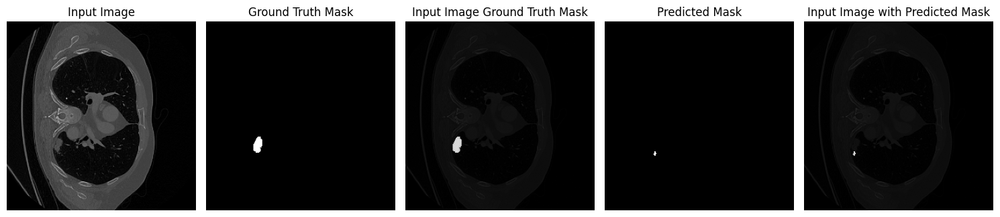

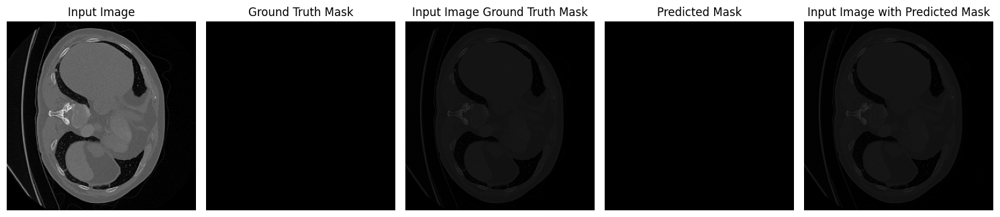

Epoch 33| Train_loss: 0.1154| Validate_loss: 0.5518| Val IOU: 0.3316| Val Best IOU 0.5209| Val Dice Coefficient 0.4602


Epoch 34/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


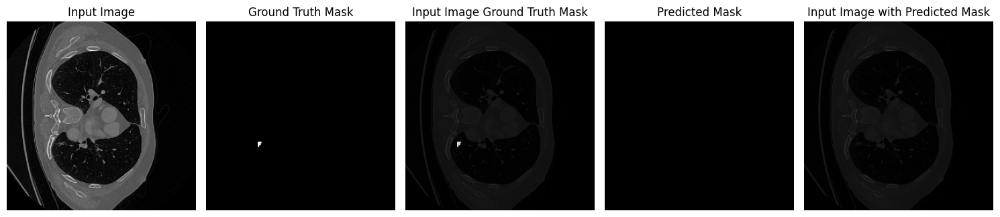

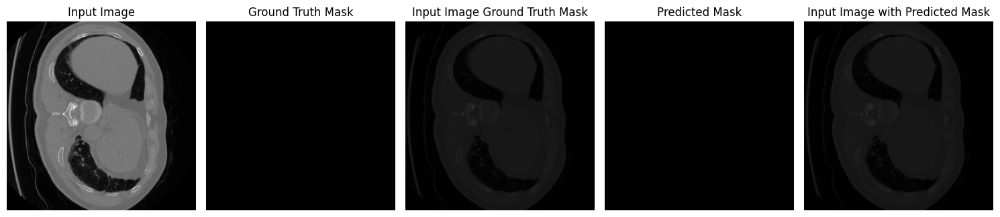

Epoch 34| Train_loss: 0.1164| Validate_loss: 0.4022| Val IOU: 0.4601| Val Best IOU 0.5209| Val Dice Coefficient 0.6082


Epoch 35/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


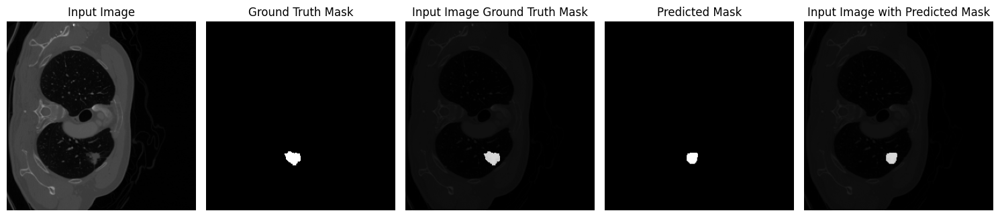

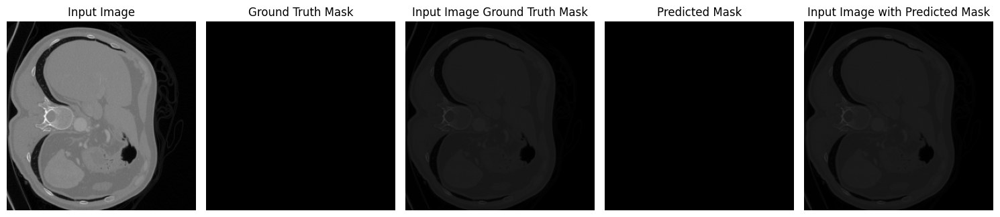

Epoch 35| Train_loss: 0.1134| Validate_loss: 0.5034| Val IOU: 0.3712| Val Best IOU 0.5209| Val Dice Coefficient 0.5083


Epoch 36/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


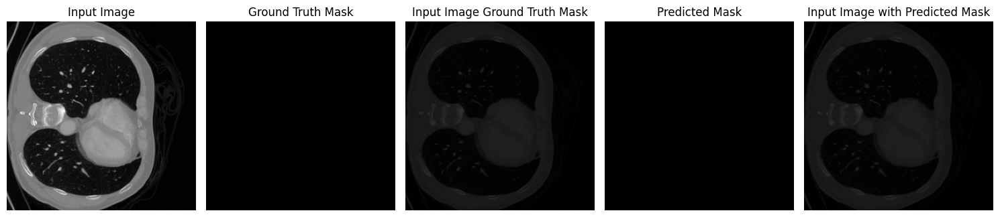

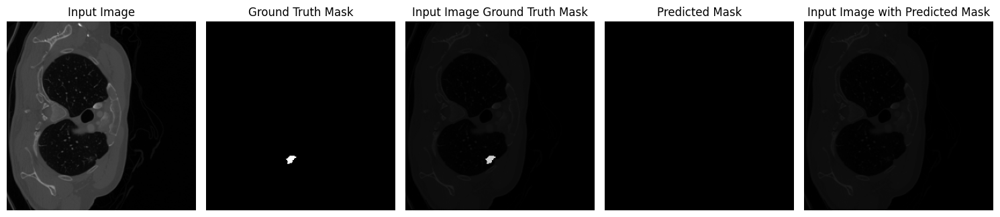

Epoch 36| Train_loss: 0.1108| Validate_loss: 0.4924| Val IOU: 0.3778| Val Best IOU 0.5209| Val Dice Coefficient 0.5187


Epoch 37/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


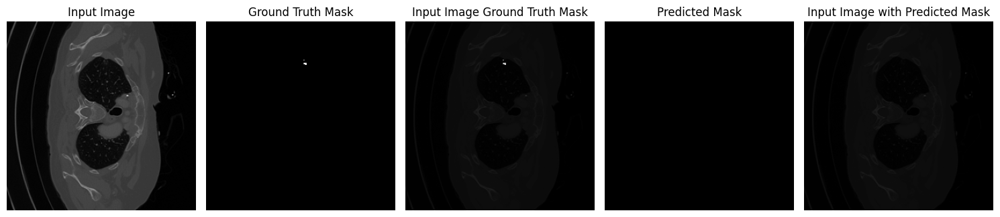

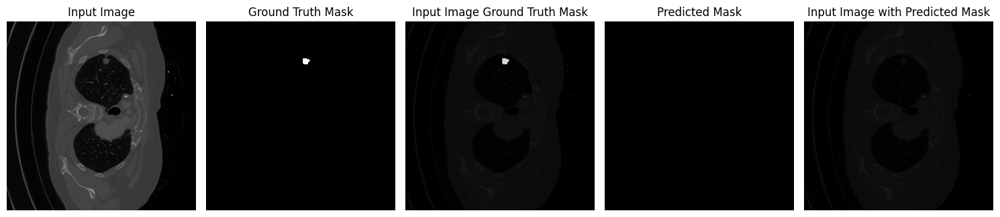

Epoch 37| Train_loss: 0.1099| Validate_loss: 0.5039| Val IOU: 0.3835| Val Best IOU 0.5209| Val Dice Coefficient 0.5069


Epoch 38/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


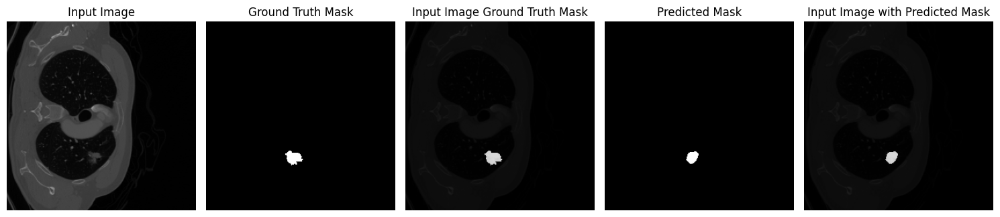

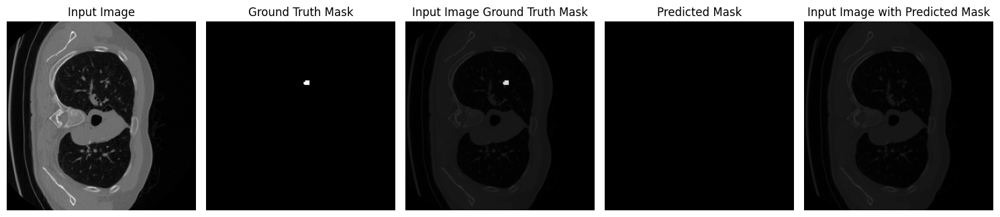

Epoch 38| Train_loss: 0.1128| Validate_loss: 0.5158| Val IOU: 0.3602| Val Best IOU 0.5209| Val Dice Coefficient 0.4967


Epoch 39/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


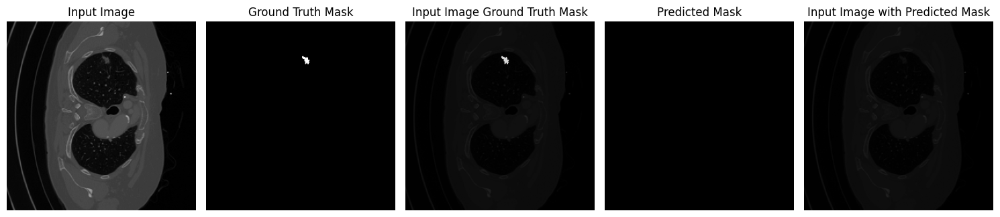

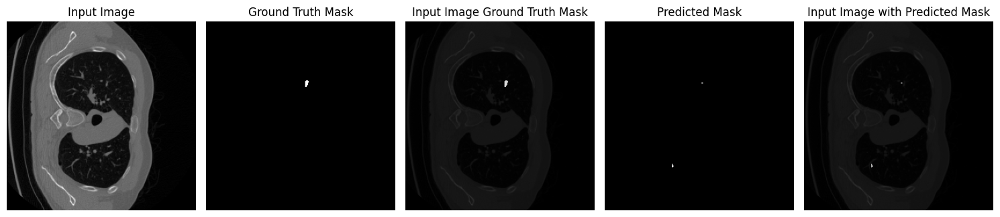

Epoch 39| Train_loss: 0.1104| Validate_loss: 0.4883| Val IOU: 0.3917| Val Best IOU 0.5209| Val Dice Coefficient 0.5223


Epoch 40/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


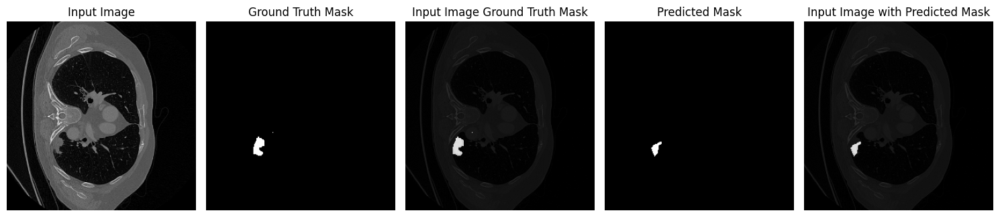

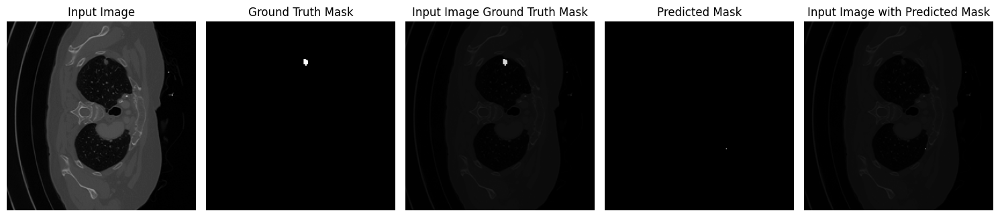

Epoch 40| Train_loss: 0.1020| Validate_loss: 0.4953| Val IOU: 0.3834| Val Best IOU 0.5209| Val Dice Coefficient 0.5151


Epoch 41/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


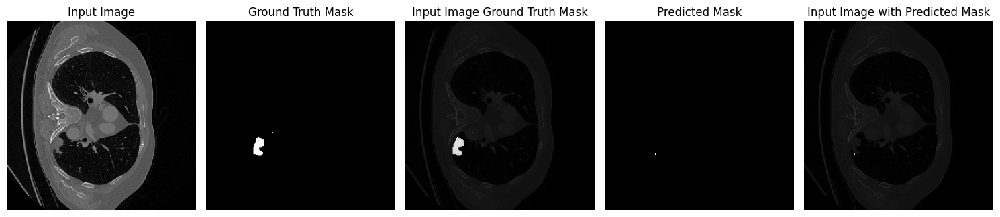

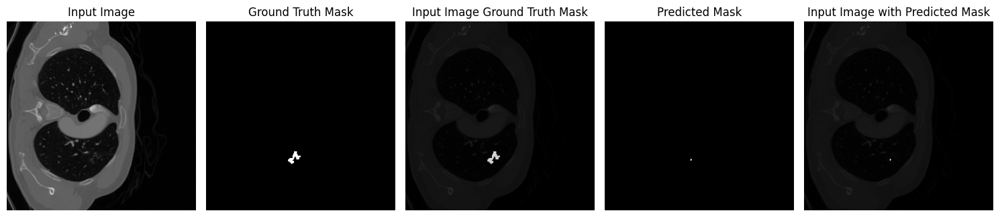

Epoch 41| Train_loss: 0.1058| Validate_loss: 0.5205| Val IOU: 0.3657| Val Best IOU 0.5209| Val Dice Coefficient 0.4908


Epoch 42/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


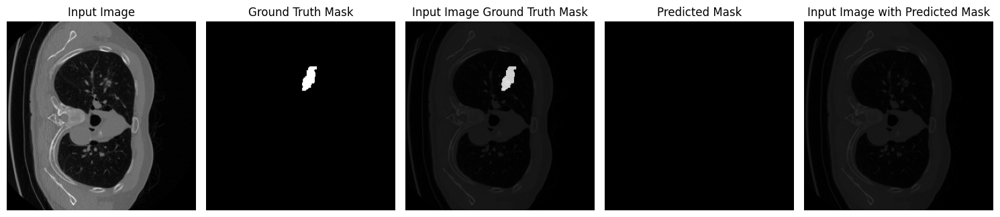

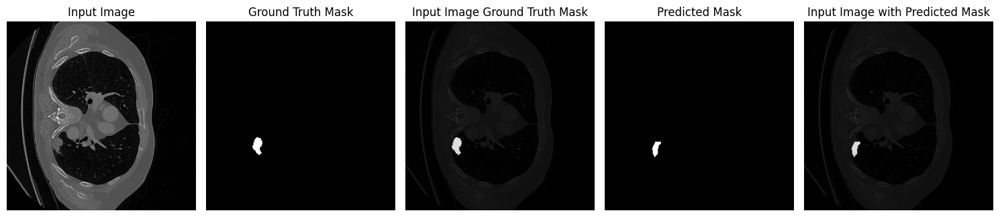

Epoch 42| Train_loss: 0.1076| Validate_loss: 0.4695| Val IOU: 0.4090| Val Best IOU 0.5209| Val Dice Coefficient 0.5436


Epoch 43/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


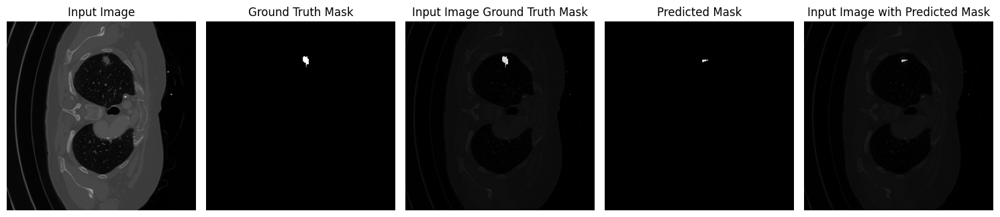

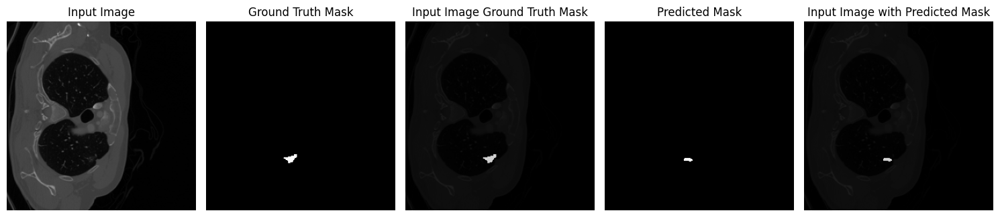

Epoch 43| Train_loss: 0.0991| Validate_loss: 0.3666| Val IOU: 0.4926| Val Best IOU 0.5209| Val Dice Coefficient 0.6436


Epoch 44/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


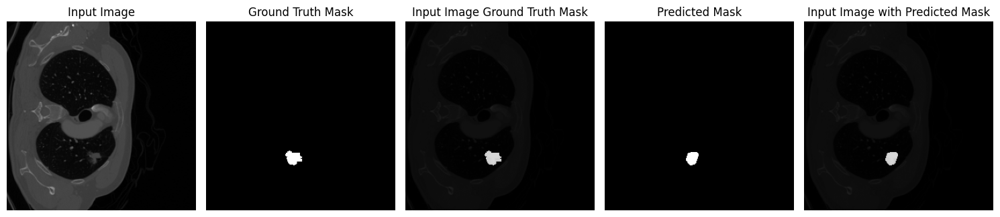

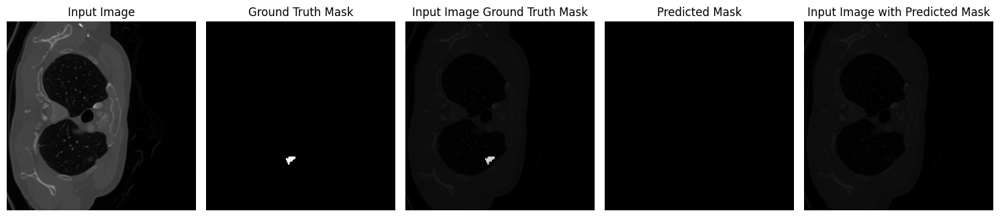

Epoch 44| Train_loss: 0.1042| Validate_loss: 0.5229| Val IOU: 0.3600| Val Best IOU 0.5209| Val Dice Coefficient 0.4899


Epoch 45/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


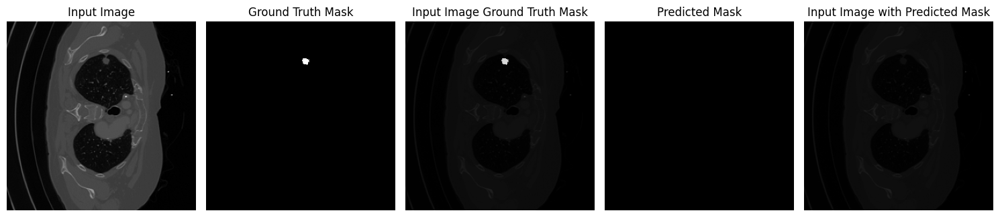

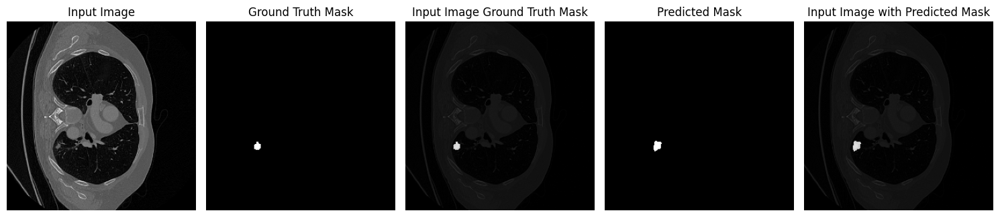

Epoch 45| Train_loss: 0.1060| Validate_loss: 0.5303| Val IOU: 0.3519| Val Best IOU 0.5209| Val Dice Coefficient 0.4823


Epoch 46/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


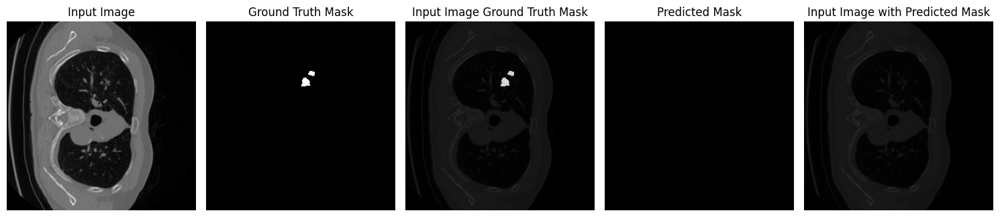

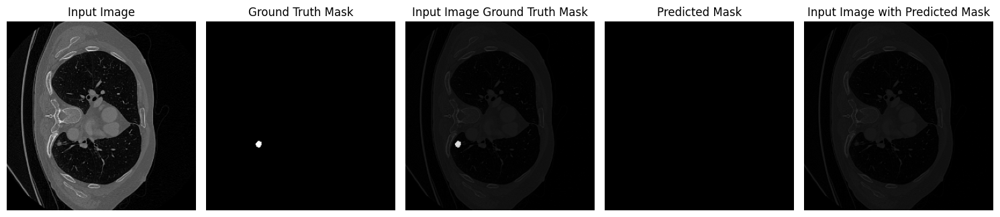

Epoch 46| Train_loss: 0.1036| Validate_loss: 0.5075| Val IOU: 0.3727| Val Best IOU 0.5209| Val Dice Coefficient 0.5022


Epoch 47/100: 100%|██████████| 458/458 [01:02<00:00,  7.28it/s]


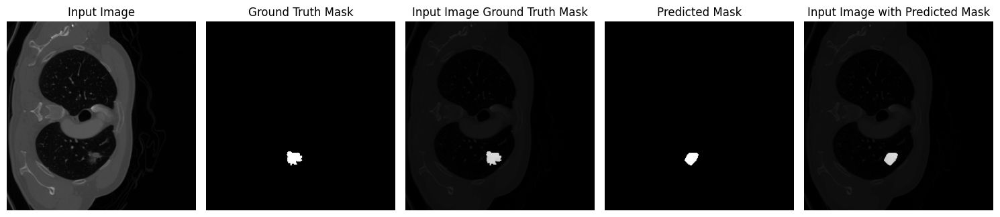

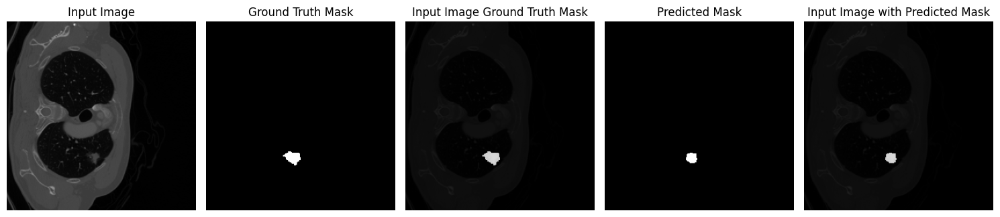

Epoch 47| Train_loss: 0.1038| Validate_loss: 0.5447| Val IOU: 0.3501| Val Best IOU 0.5209| Val Dice Coefficient 0.4681


Epoch 48/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


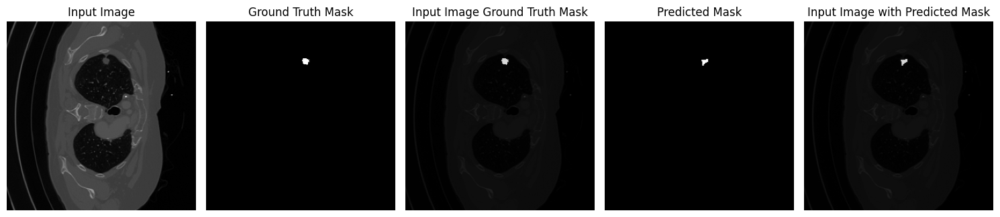

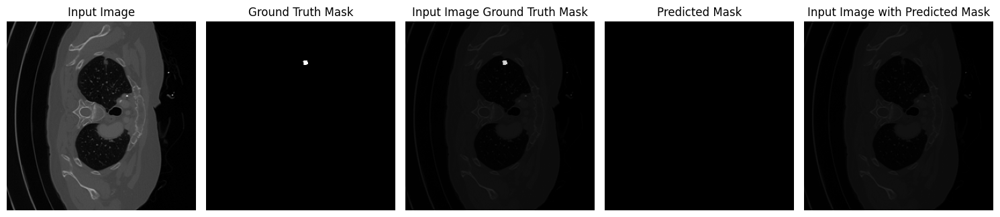

Epoch 48| Train_loss: 0.1026| Validate_loss: 0.4708| Val IOU: 0.3973| Val Best IOU 0.5209| Val Dice Coefficient 0.5394


Epoch 49/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


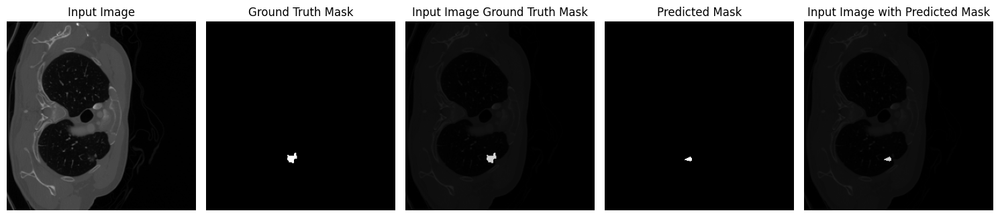

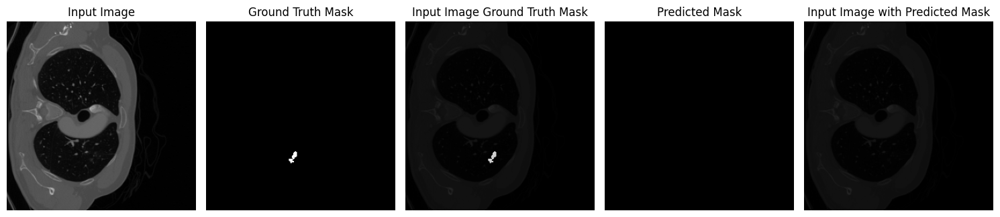

Epoch 49| Train_loss: 0.1005| Validate_loss: 0.5673| Val IOU: 0.3203| Val Best IOU 0.5209| Val Dice Coefficient 0.4449


Epoch 50/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


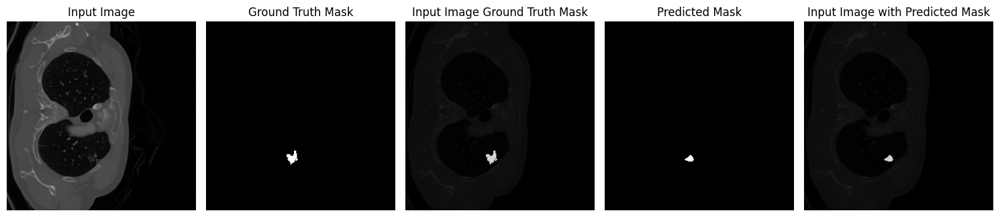

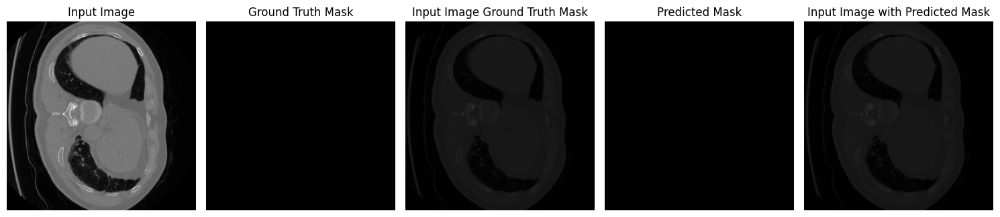

Epoch 50| Train_loss: 0.0971| Validate_loss: 0.5102| Val IOU: 0.3658| Val Best IOU 0.5209| Val Dice Coefficient 0.4966


Epoch 51/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


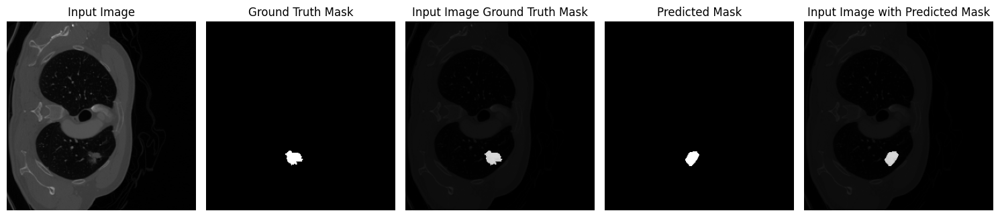

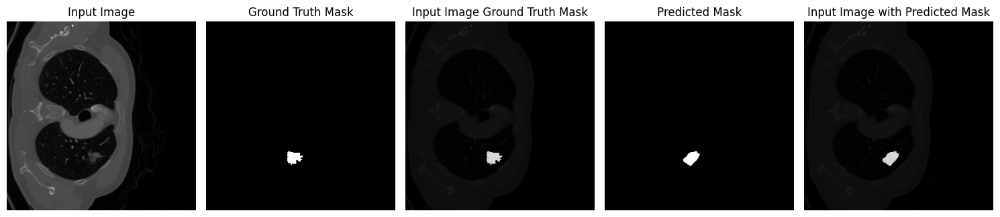

Epoch 51| Train_loss: 0.0985| Validate_loss: 0.4838| Val IOU: 0.3970| Val Best IOU 0.5209| Val Dice Coefficient 0.5303


Epoch 52/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


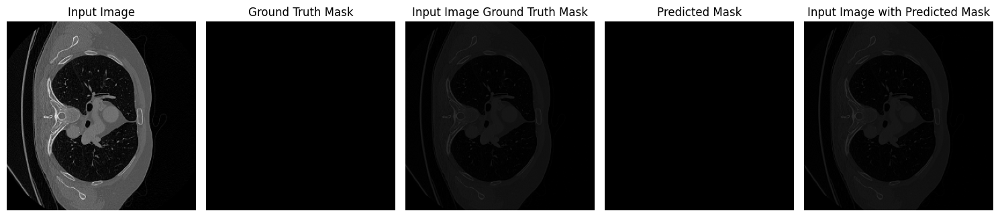

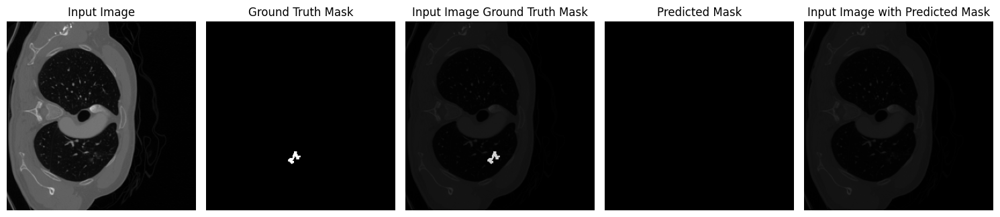

Epoch 52| Train_loss: 0.0989| Validate_loss: 0.4754| Val IOU: 0.4050| Val Best IOU 0.5209| Val Dice Coefficient 0.5352


Epoch 53/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


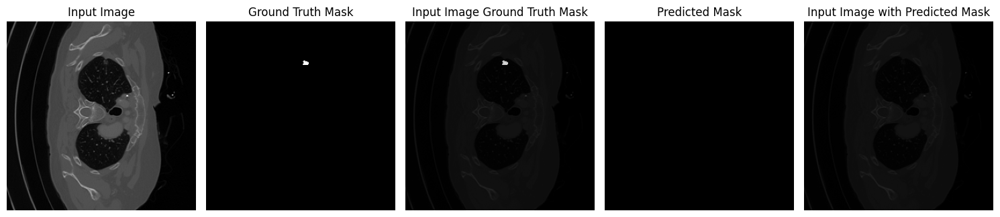

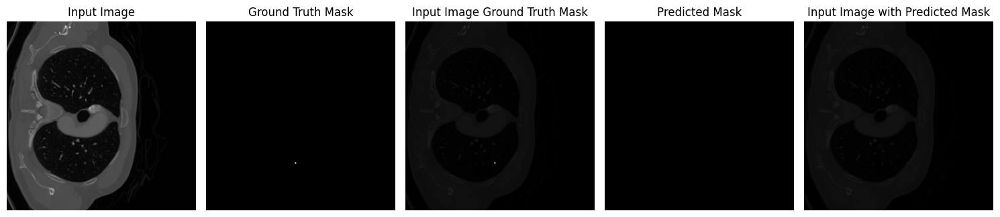

Epoch 53| Train_loss: 0.0943| Validate_loss: 0.5800| Val IOU: 0.3186| Val Best IOU 0.5209| Val Dice Coefficient 0.4307


Epoch 54/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


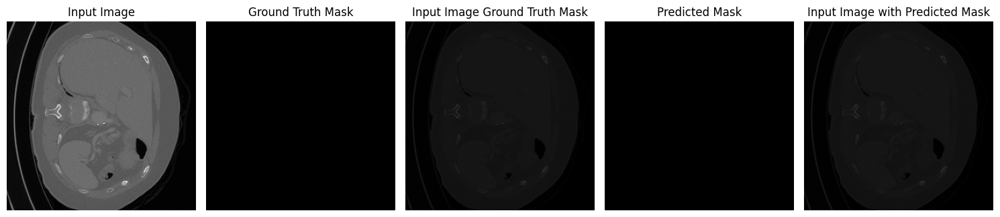

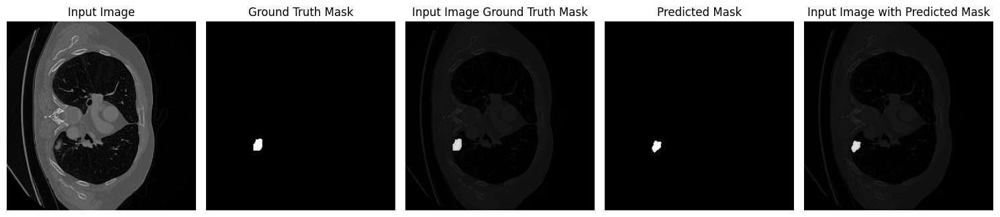

Epoch 54| Train_loss: 0.0961| Validate_loss: 0.5546| Val IOU: 0.3277| Val Best IOU 0.5209| Val Dice Coefficient 0.4580


Epoch 55/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


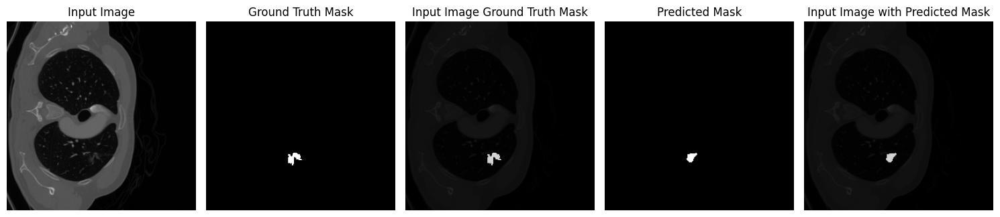

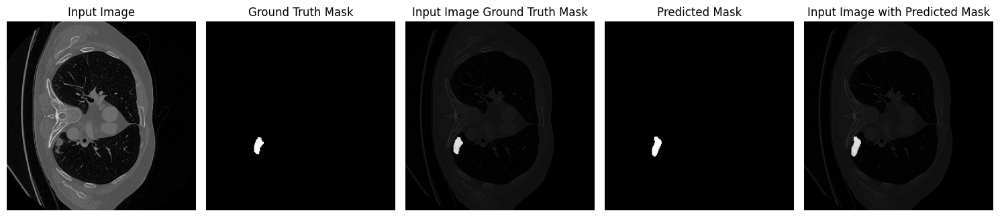

Epoch 55| Train_loss: 0.1019| Validate_loss: 0.5019| Val IOU: 0.3858| Val Best IOU 0.5209| Val Dice Coefficient 0.5118


Epoch 56/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


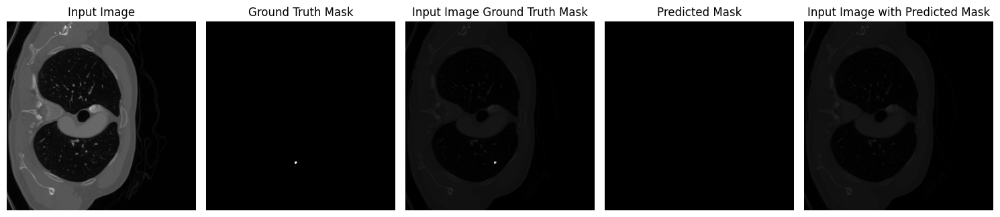

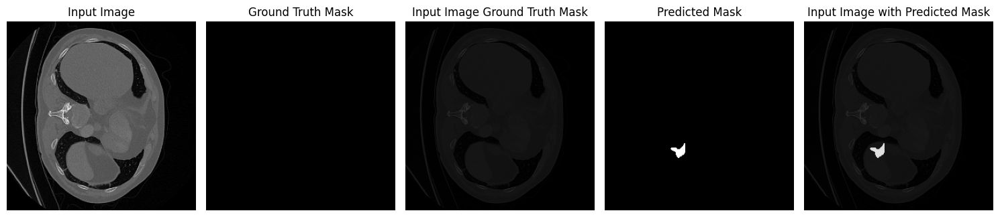

Epoch 56| Train_loss: 0.0977| Validate_loss: 0.5332| Val IOU: 0.3567| Val Best IOU 0.5209| Val Dice Coefficient 0.4797


Epoch 57/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


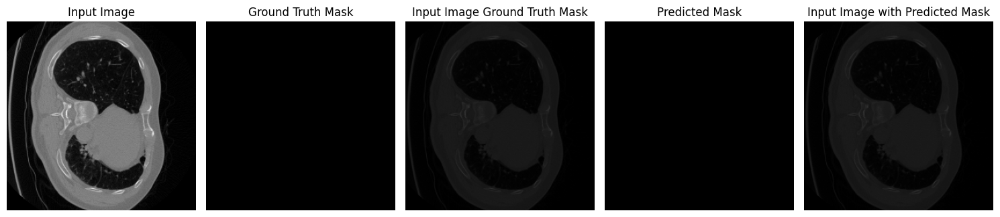

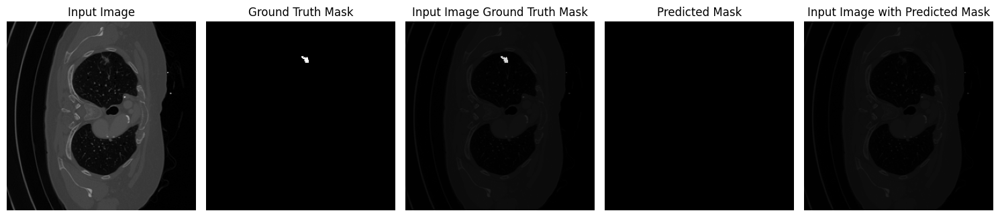

Epoch 57| Train_loss: 0.0992| Validate_loss: 0.4610| Val IOU: 0.4100| Val Best IOU 0.5209| Val Dice Coefficient 0.5523


Epoch 58/100: 100%|██████████| 458/458 [01:02<00:00,  7.29it/s]


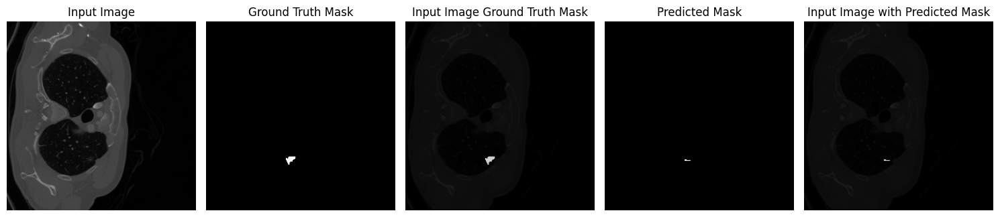

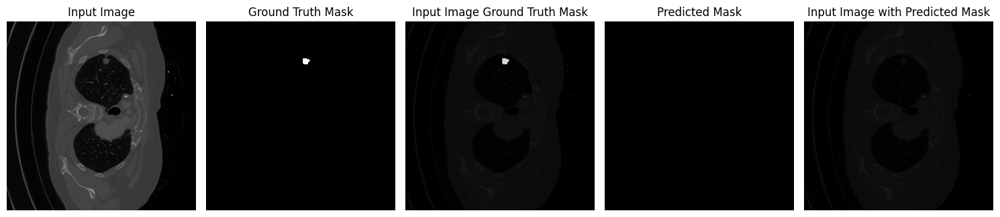

Epoch 58| Train_loss: 0.0958| Validate_loss: 0.4434| Val IOU: 0.4354| Val Best IOU 0.5209| Val Dice Coefficient 0.5721


Epoch 59/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


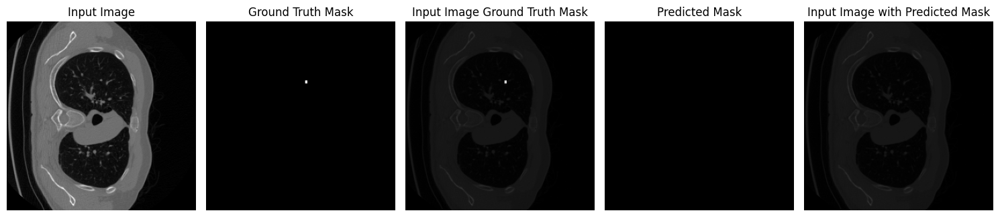

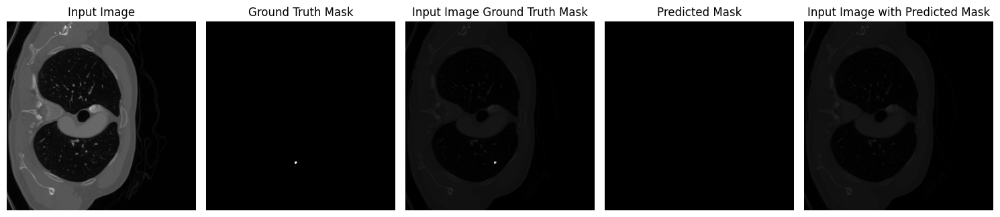

Epoch 59| Train_loss: 0.0961| Validate_loss: 0.4576| Val IOU: 0.4144| Val Best IOU 0.5209| Val Dice Coefficient 0.5535


Epoch 60/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


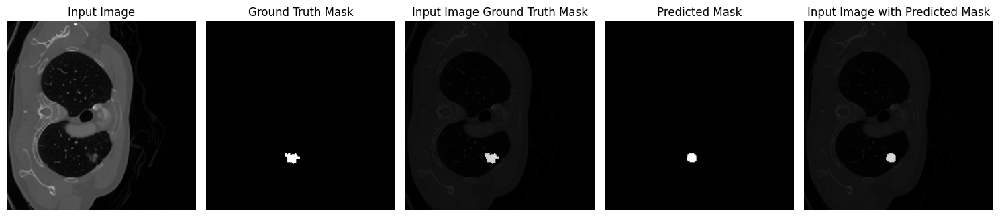

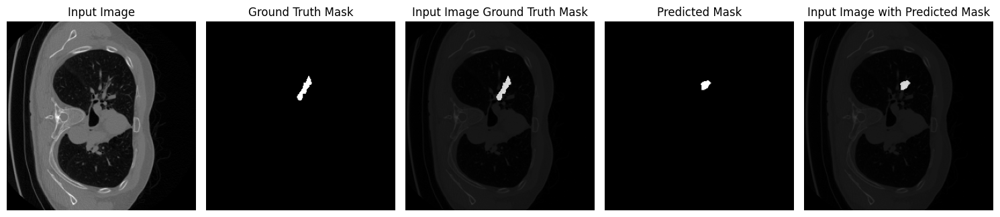

Epoch 60| Train_loss: 0.0958| Validate_loss: 0.4666| Val IOU: 0.4118| Val Best IOU 0.5209| Val Dice Coefficient 0.5443


Epoch 61/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


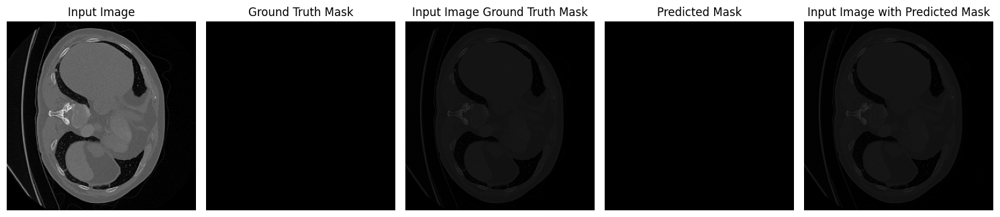

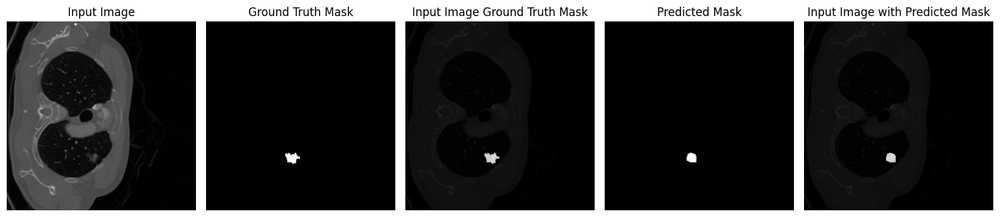

Epoch 61| Train_loss: 0.0922| Validate_loss: 0.4719| Val IOU: 0.3963| Val Best IOU 0.5209| Val Dice Coefficient 0.5390


Epoch 62/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


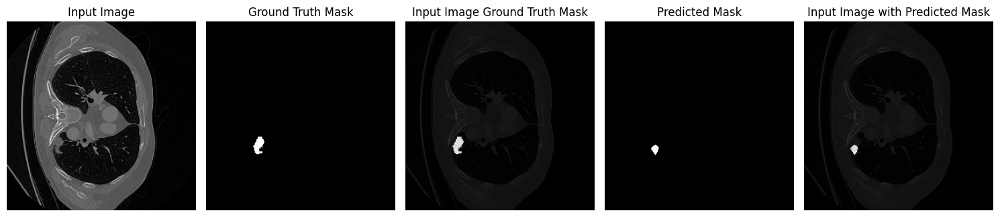

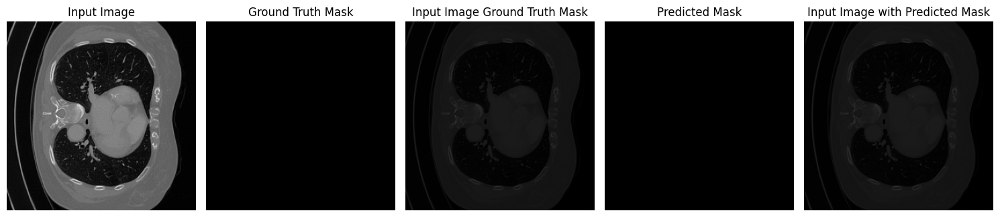

Epoch 62| Train_loss: 0.0890| Validate_loss: 0.4944| Val IOU: 0.3782| Val Best IOU 0.5209| Val Dice Coefficient 0.5131


Epoch 63/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


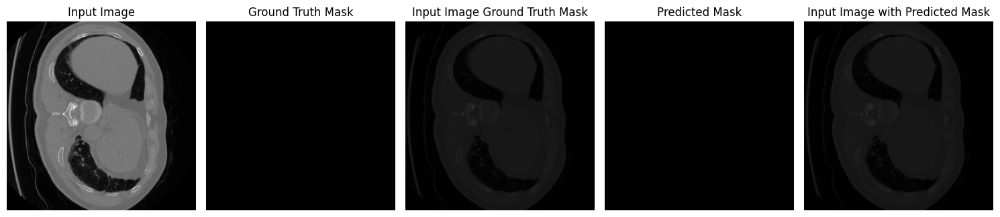

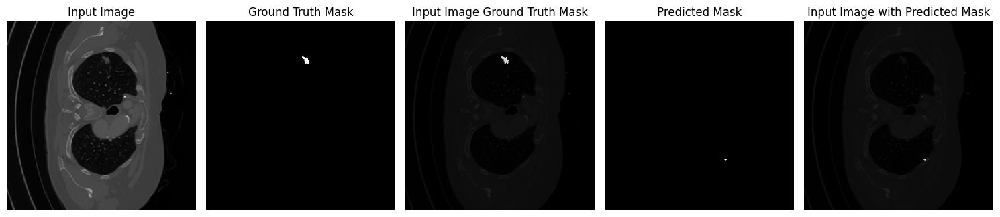

Epoch 63| Train_loss: 0.0945| Validate_loss: 0.4819| Val IOU: 0.3896| Val Best IOU 0.5209| Val Dice Coefficient 0.5299


Epoch 64/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


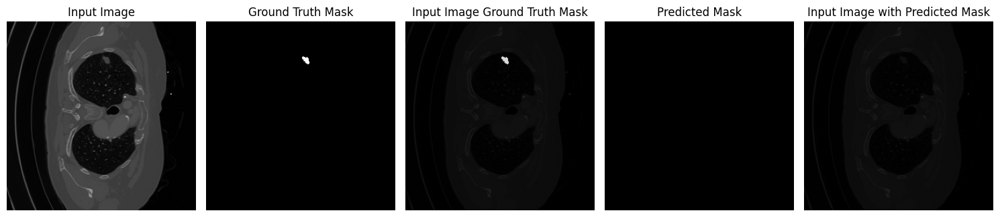

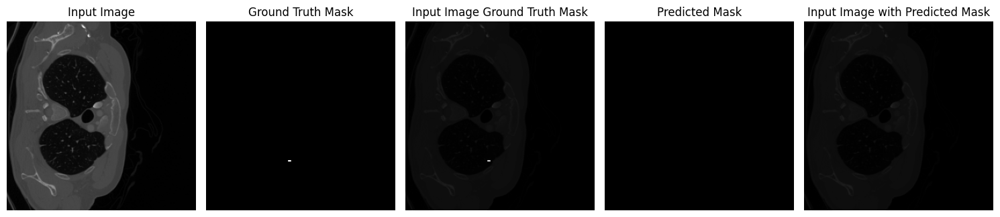

Epoch 64| Train_loss: 0.0872| Validate_loss: 0.5610| Val IOU: 0.3369| Val Best IOU 0.5209| Val Dice Coefficient 0.4494


Epoch 65/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


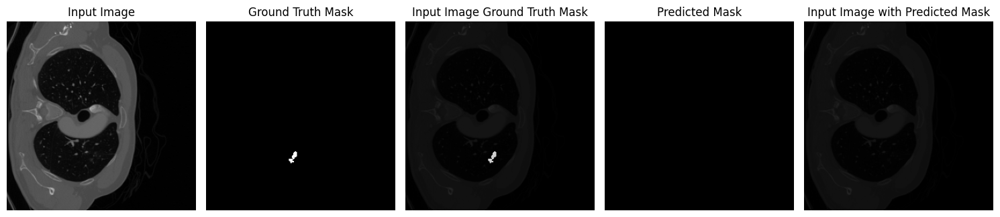

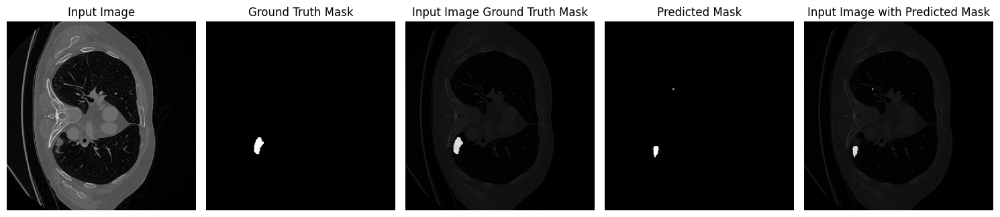

Epoch 65| Train_loss: 0.0861| Validate_loss: 0.4913| Val IOU: 0.3826| Val Best IOU 0.5209| Val Dice Coefficient 0.5175


Epoch 66/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


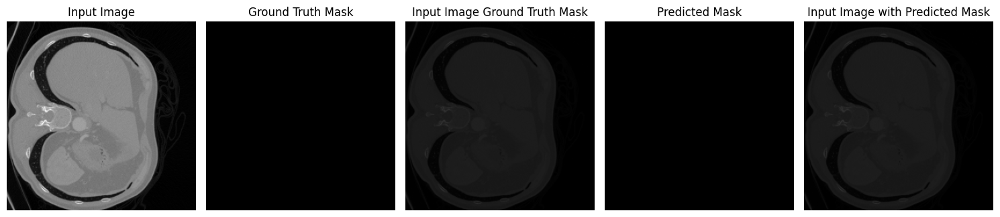

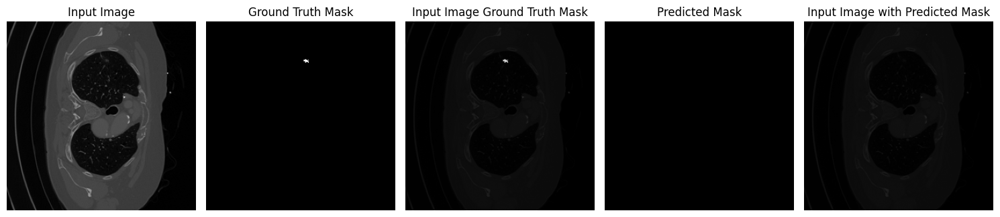

Epoch 66| Train_loss: 0.0853| Validate_loss: 0.4194| Val IOU: 0.4500| Val Best IOU 0.5209| Val Dice Coefficient 0.5930


Epoch 67/100: 100%|██████████| 458/458 [01:02<00:00,  7.31it/s]


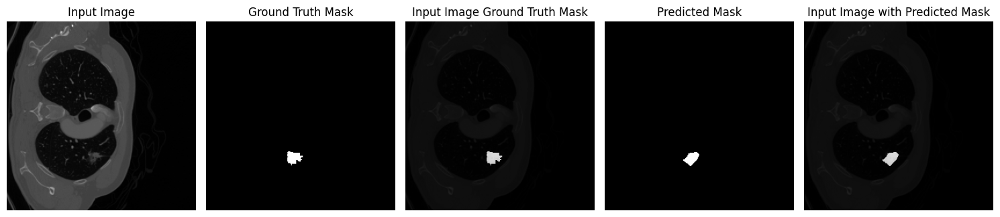

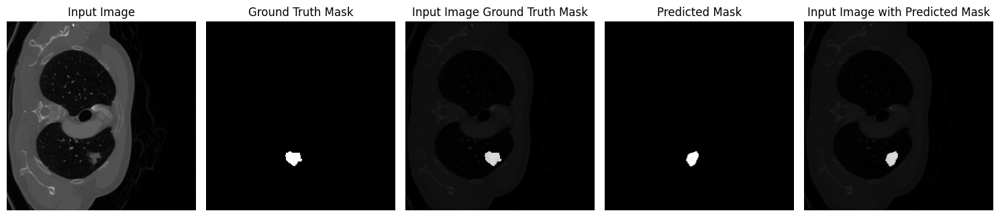

Epoch 67| Train_loss: 0.0894| Validate_loss: 0.5551| Val IOU: 0.3292| Val Best IOU 0.5209| Val Dice Coefficient 0.4618


Epoch 68/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


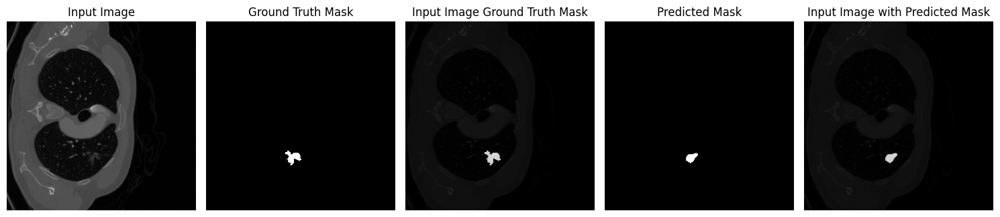

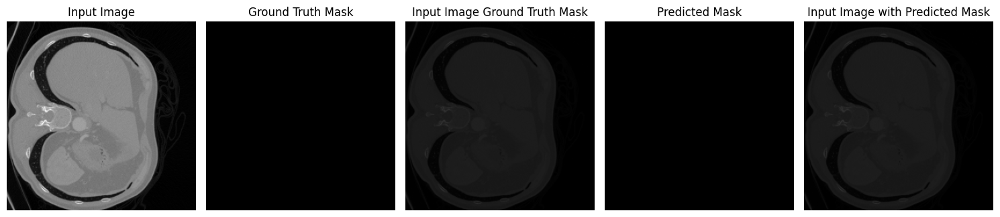

Epoch 68| Train_loss: 0.0904| Validate_loss: 0.4566| Val IOU: 0.4157| Val Best IOU 0.5209| Val Dice Coefficient 0.5502


Epoch 69/100: 100%|██████████| 458/458 [01:02<00:00,  7.33it/s]


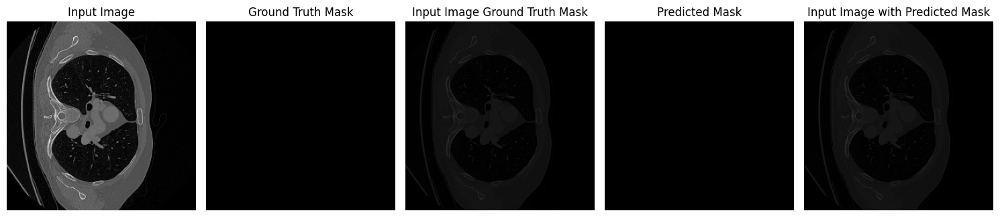

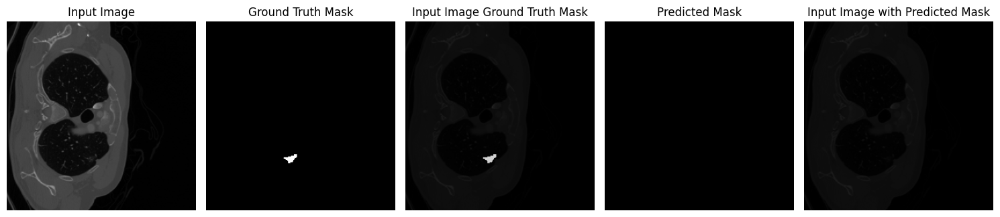

Epoch 69| Train_loss: 0.0878| Validate_loss: 0.5629| Val IOU: 0.3244| Val Best IOU 0.5209| Val Dice Coefficient 0.4454


Epoch 70/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


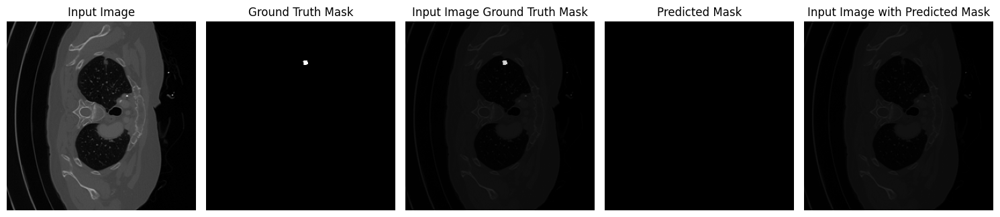

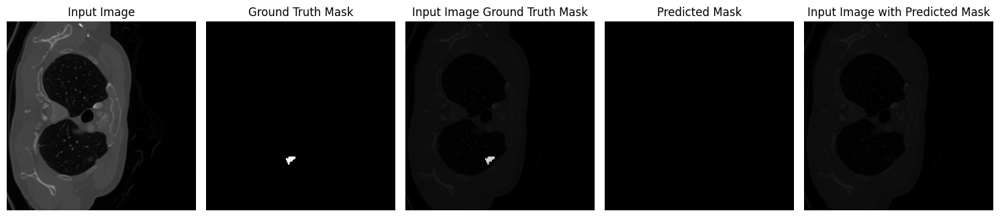

Epoch 70| Train_loss: 0.0909| Validate_loss: 0.5239| Val IOU: 0.3579| Val Best IOU 0.5209| Val Dice Coefficient 0.4878


Epoch 71/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


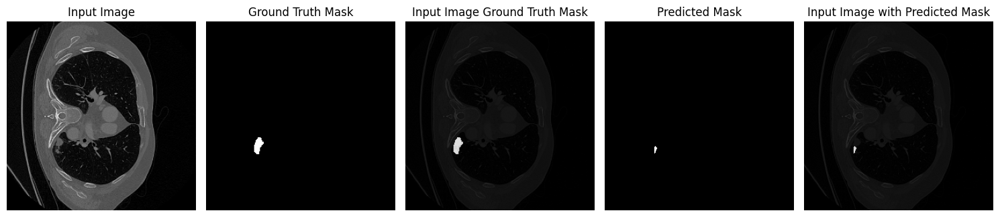

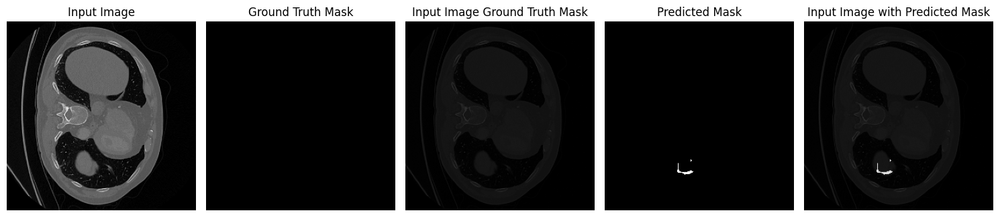

Epoch 71| Train_loss: 0.0898| Validate_loss: 0.6114| Val IOU: 0.2854| Val Best IOU 0.5209| Val Dice Coefficient 0.4047


Epoch 72/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


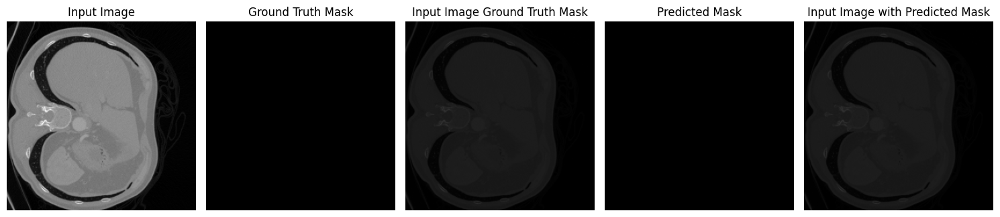

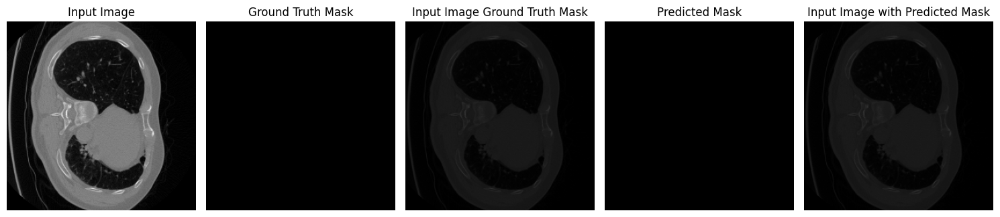

Epoch 72| Train_loss: 0.0883| Validate_loss: 0.5925| Val IOU: 0.3075| Val Best IOU 0.5209| Val Dice Coefficient 0.4184


Epoch 73/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


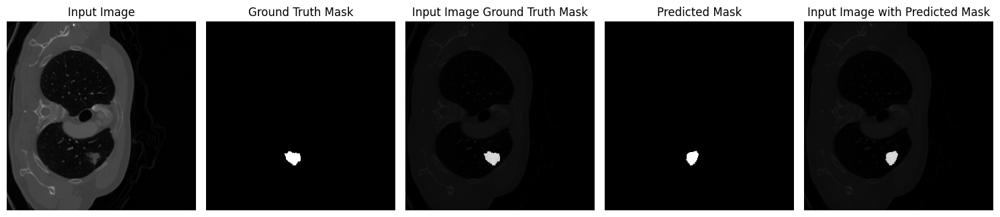

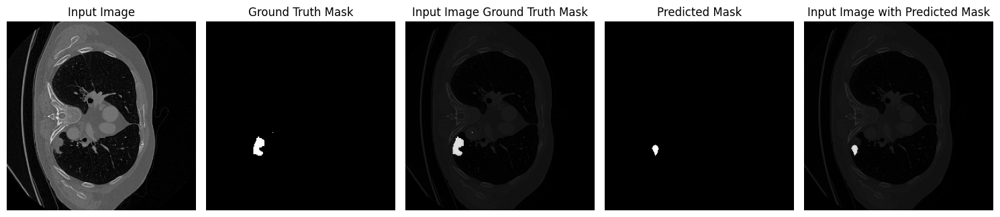

Epoch 73| Train_loss: 0.0829| Validate_loss: 0.5613| Val IOU: 0.3236| Val Best IOU 0.5209| Val Dice Coefficient 0.4539


Epoch 74/100: 100%|██████████| 458/458 [01:02<00:00,  7.33it/s]


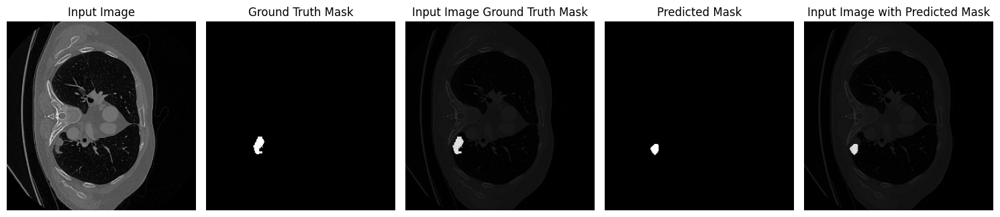

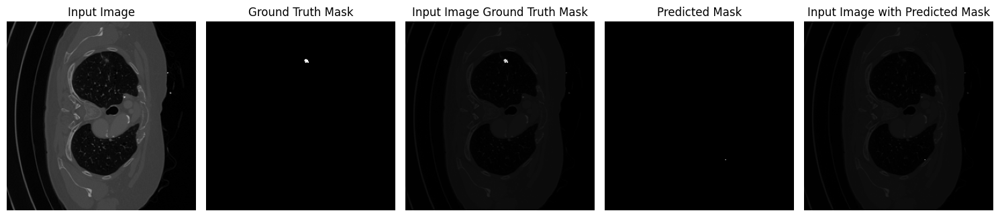

Epoch 74| Train_loss: 0.0847| Validate_loss: 0.4968| Val IOU: 0.3869| Val Best IOU 0.5209| Val Dice Coefficient 0.5150


Epoch 75/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


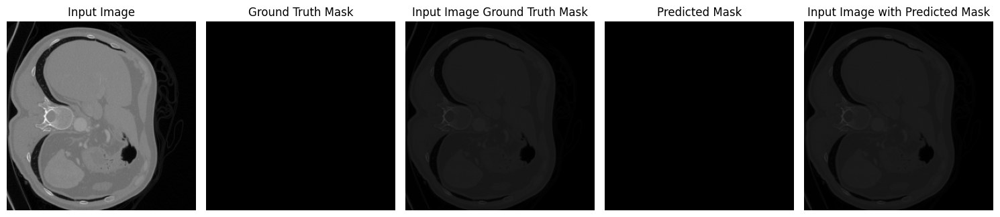

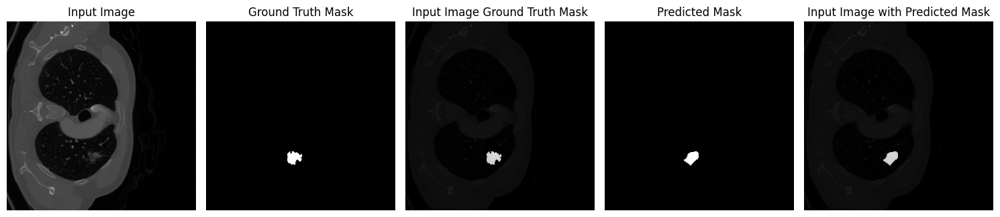

Epoch 75| Train_loss: 0.0834| Validate_loss: 0.5412| Val IOU: 0.3449| Val Best IOU 0.5209| Val Dice Coefficient 0.4719


Epoch 76/100: 100%|██████████| 458/458 [01:02<00:00,  7.32it/s]


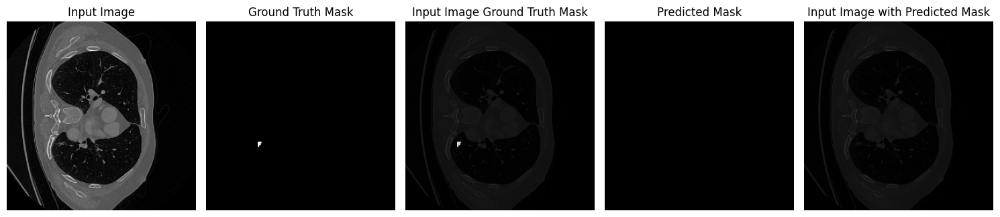

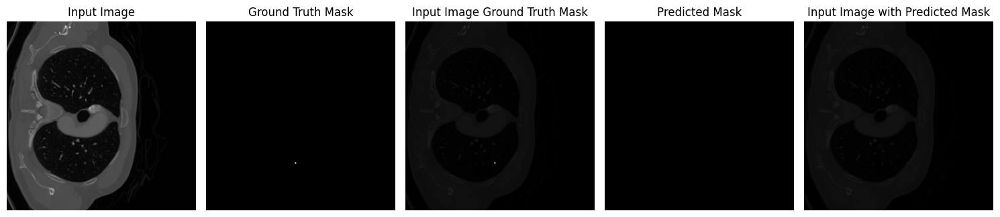

Epoch 76| Train_loss: 0.0836| Validate_loss: 0.5615| Val IOU: 0.3397| Val Best IOU 0.5209| Val Dice Coefficient 0.4556


Epoch 77/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


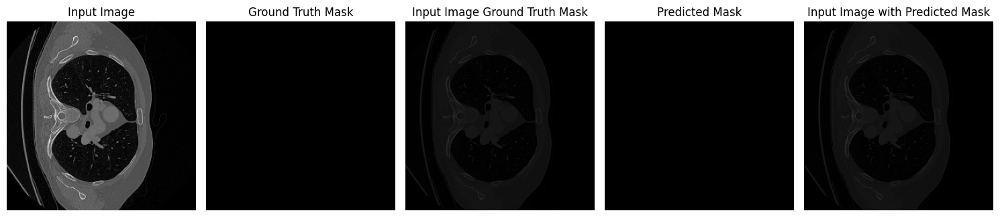

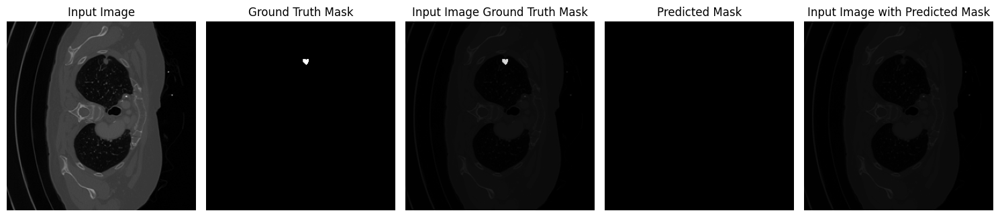

Epoch 77| Train_loss: 0.0821| Validate_loss: 0.5686| Val IOU: 0.3161| Val Best IOU 0.5209| Val Dice Coefficient 0.4477


Epoch 78/100: 100%|██████████| 458/458 [01:02<00:00,  7.30it/s]


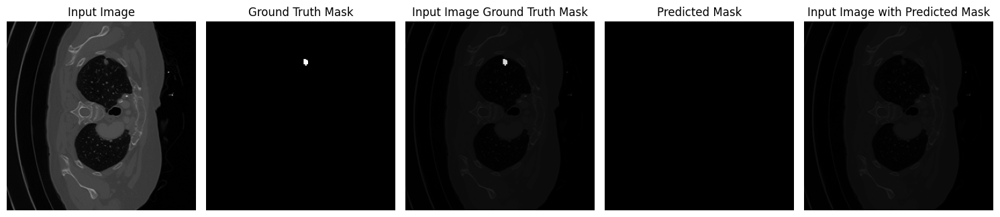

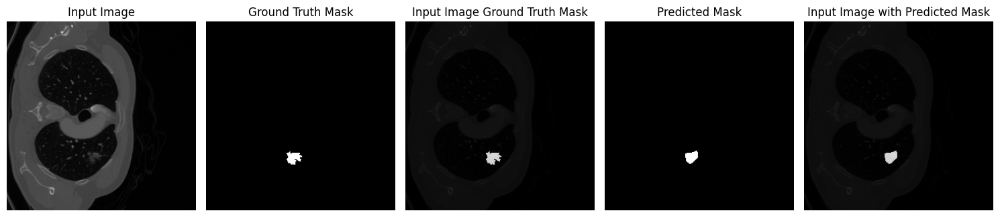

Epoch 78| Train_loss: 0.0869| Validate_loss: 0.5463| Val IOU: 0.3420| Val Best IOU 0.5209| Val Dice Coefficient 0.4670


Epoch 79/100: 100%|██████████| 458/458 [01:02<00:00,  7.33it/s]


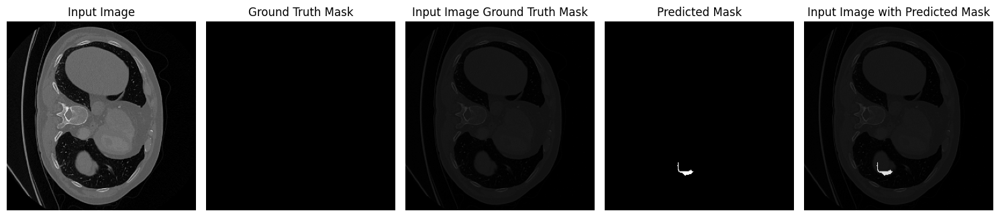

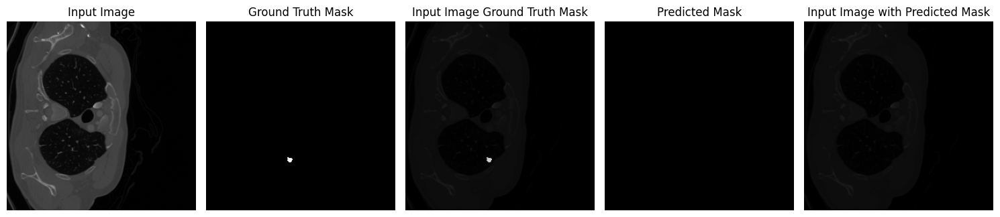

Epoch 79| Train_loss: 0.0844| Validate_loss: 0.4715| Val IOU: 0.4072| Val Best IOU 0.5209| Val Dice Coefficient 0.5397


Epoch 80/100: 100%|██████████| 458/458 [01:02<00:00,  7.33it/s]


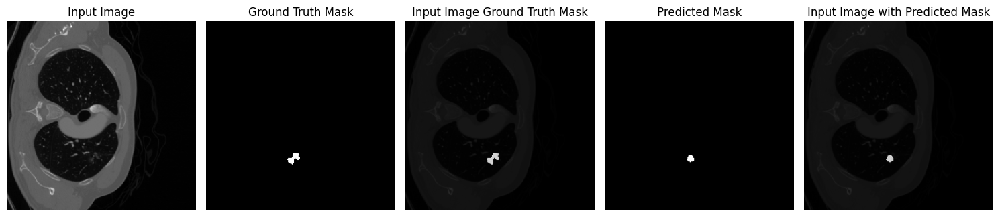

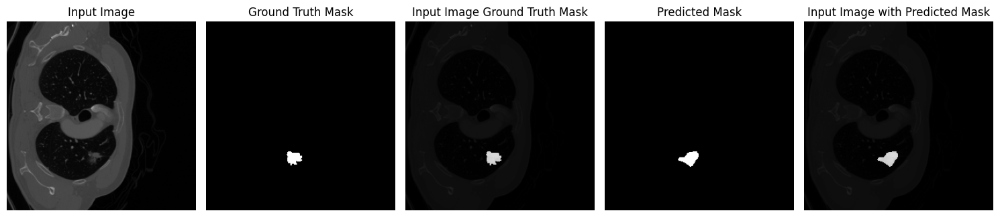

Epoch 80| Train_loss: 0.0880| Validate_loss: 0.4446| Val IOU: 0.4194| Val Best IOU 0.5209| Val Dice Coefficient 0.5705


Epoch 81/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


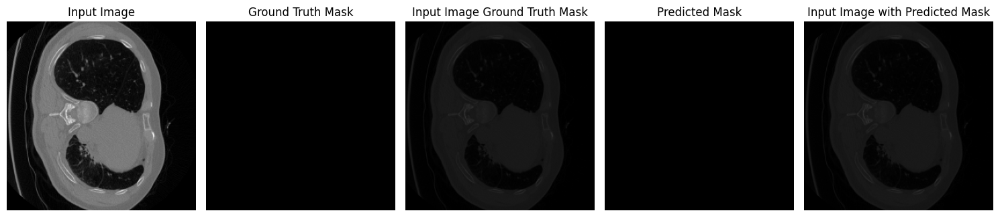

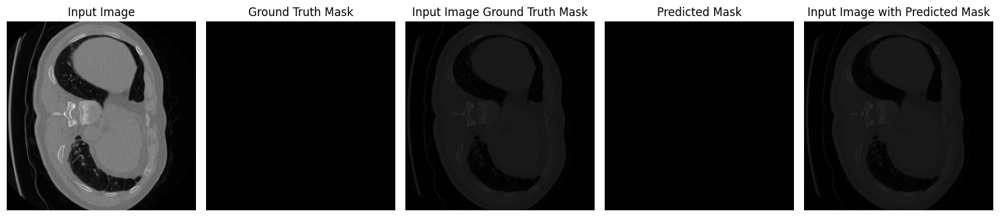

Epoch 81| Train_loss: 0.0850| Validate_loss: 0.5864| Val IOU: 0.3090| Val Best IOU 0.5209| Val Dice Coefficient 0.4274


Epoch 82/100: 100%|██████████| 458/458 [01:02<00:00,  7.34it/s]


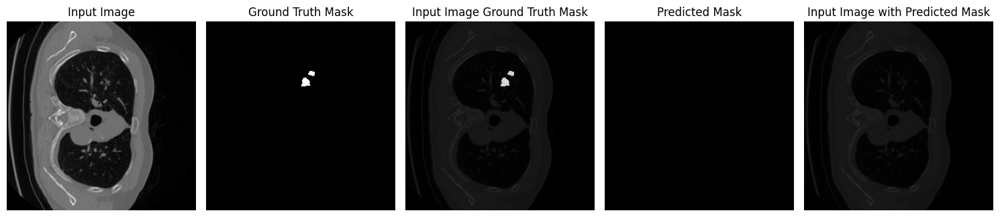

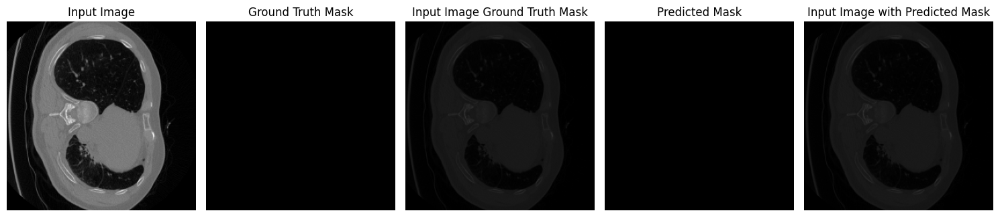

Epoch 82| Train_loss: 0.0857| Validate_loss: 0.5794| Val IOU: 0.3165| Val Best IOU 0.5209| Val Dice Coefficient 0.4359


Epoch 83/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


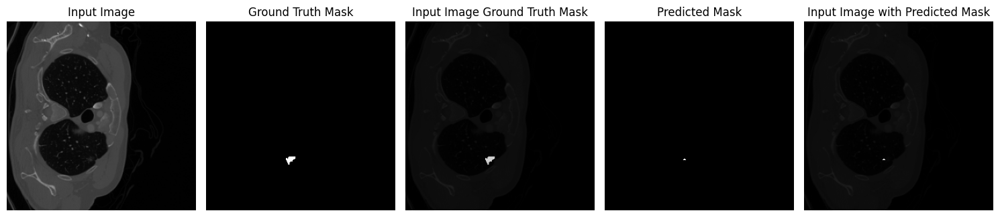

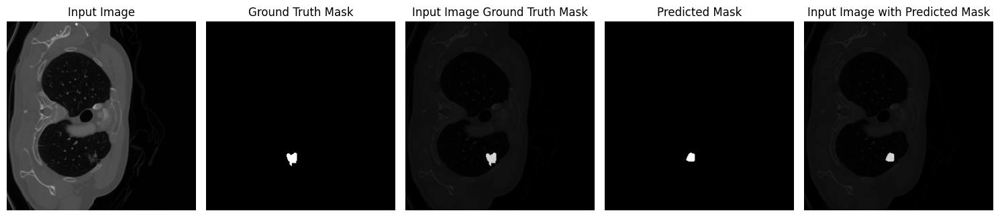

Epoch 83| Train_loss: 0.0848| Validate_loss: 0.5707| Val IOU: 0.3213| Val Best IOU 0.5209| Val Dice Coefficient 0.4412


Epoch 84/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


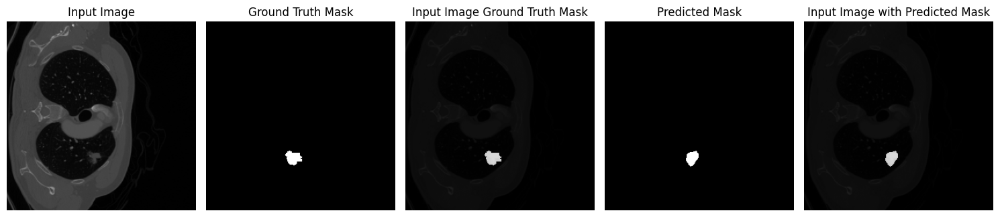

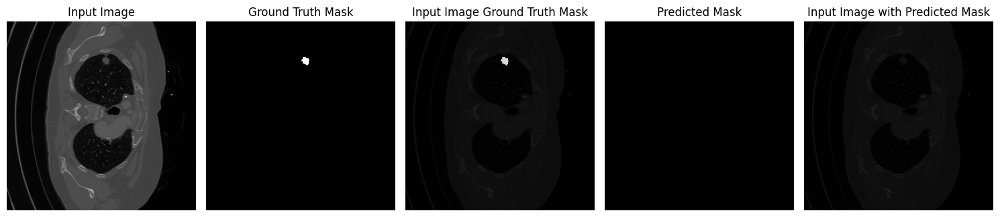

Epoch 84| Train_loss: 0.0858| Validate_loss: 0.4737| Val IOU: 0.3974| Val Best IOU 0.5209| Val Dice Coefficient 0.5418


Epoch 85/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


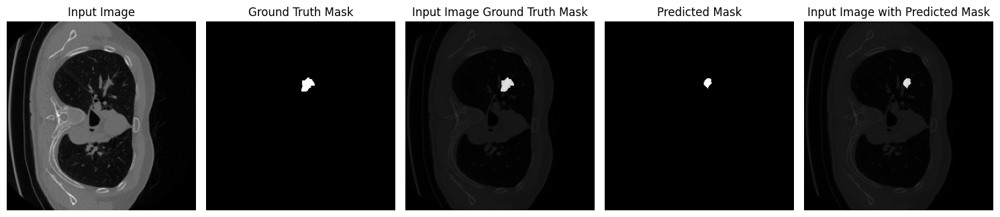

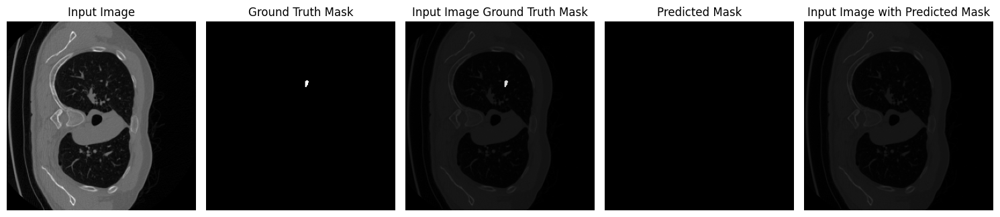

Epoch 85| Train_loss: 0.0805| Validate_loss: 0.6168| Val IOU: 0.2829| Val Best IOU 0.5209| Val Dice Coefficient 0.4021


Epoch 86/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


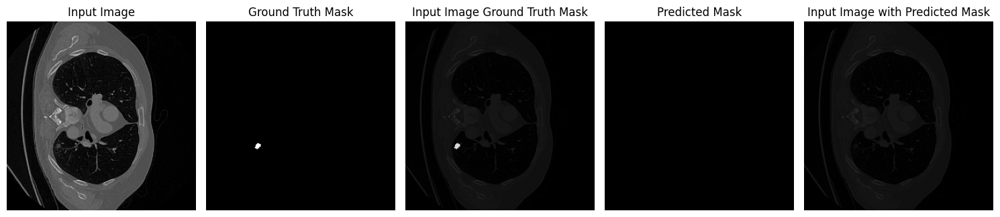

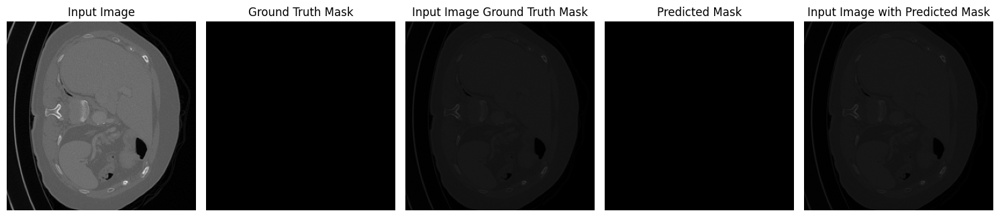

Epoch 86| Train_loss: 0.0821| Validate_loss: 0.4942| Val IOU: 0.3761| Val Best IOU 0.5209| Val Dice Coefficient 0.5215


Epoch 87/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


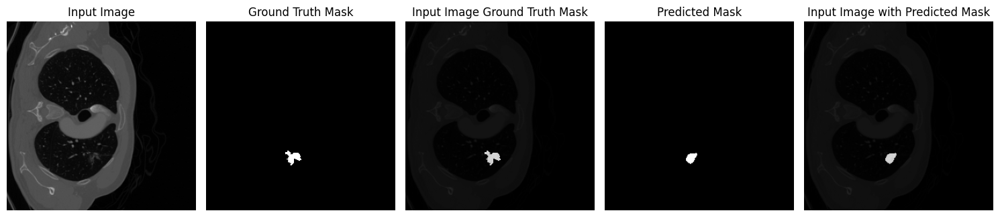

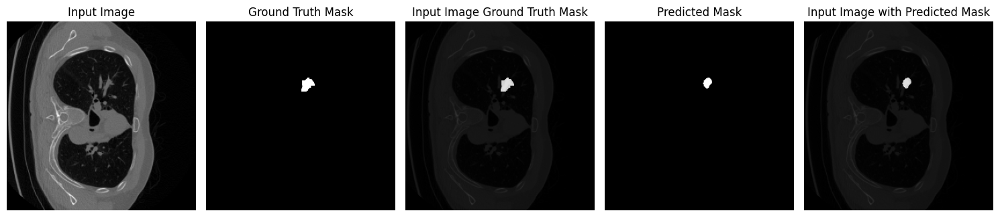

Epoch 87| Train_loss: 0.0815| Validate_loss: 0.5535| Val IOU: 0.3364| Val Best IOU 0.5209| Val Dice Coefficient 0.4608


Epoch 88/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


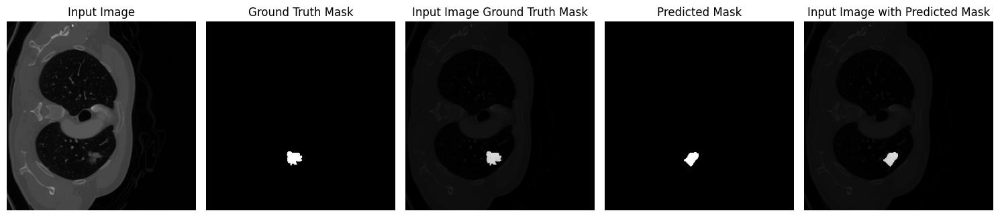

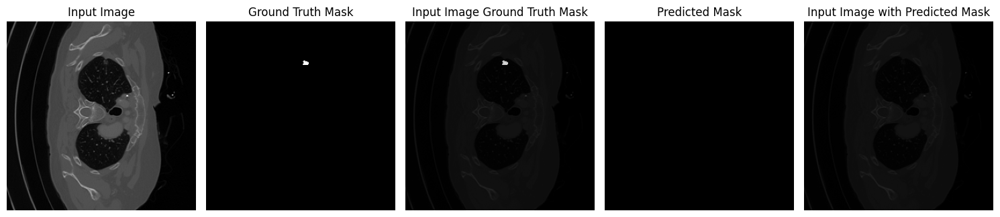

Epoch 88| Train_loss: 0.0796| Validate_loss: 0.5594| Val IOU: 0.3287| Val Best IOU 0.5209| Val Dice Coefficient 0.4572


Epoch 89/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


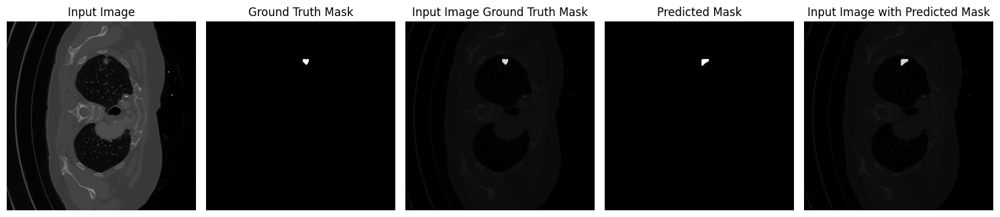

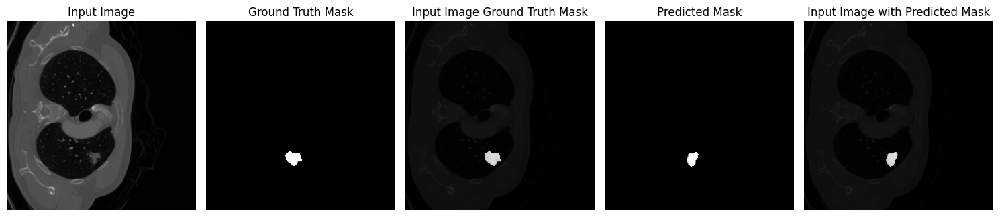

Epoch 89| Train_loss: 0.0827| Validate_loss: 0.5089| Val IOU: 0.3581| Val Best IOU 0.5209| Val Dice Coefficient 0.5054


Epoch 90/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


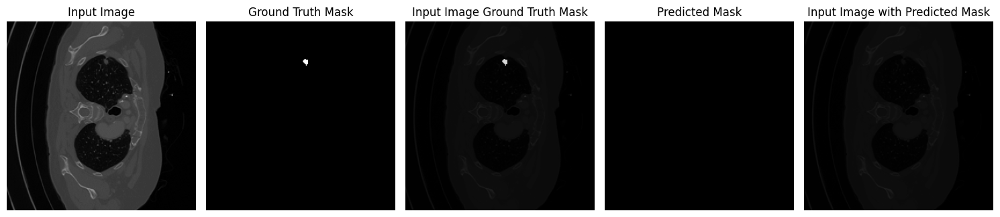

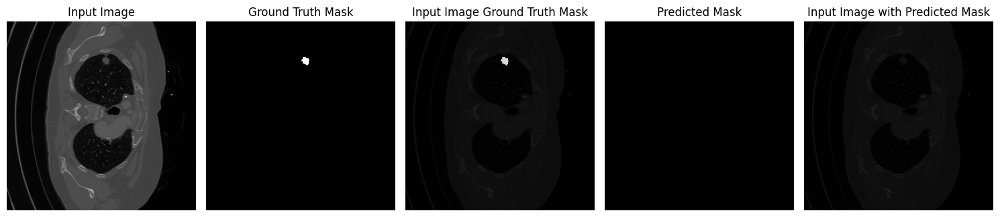

Epoch 90| Train_loss: 0.0830| Validate_loss: 0.5129| Val IOU: 0.3543| Val Best IOU 0.5209| Val Dice Coefficient 0.5075


Epoch 91/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


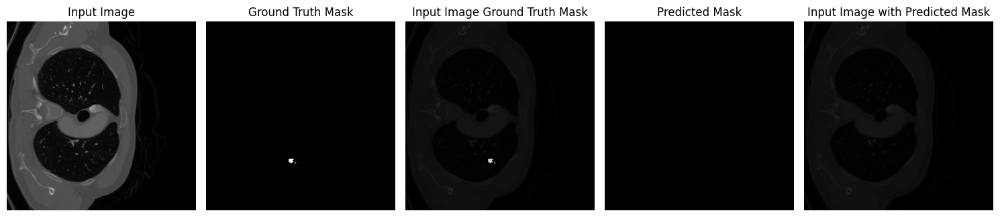

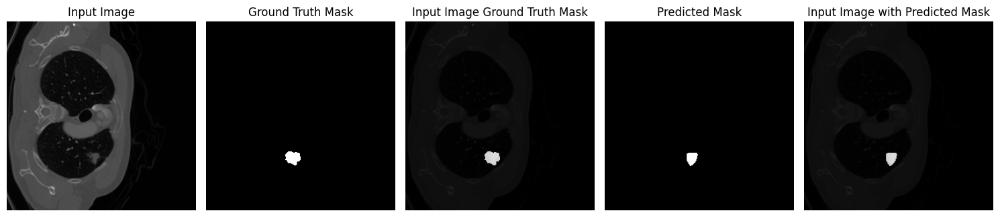

Epoch 91| Train_loss: 0.0819| Validate_loss: 0.5836| Val IOU: 0.3111| Val Best IOU 0.5209| Val Dice Coefficient 0.4324


Epoch 92/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


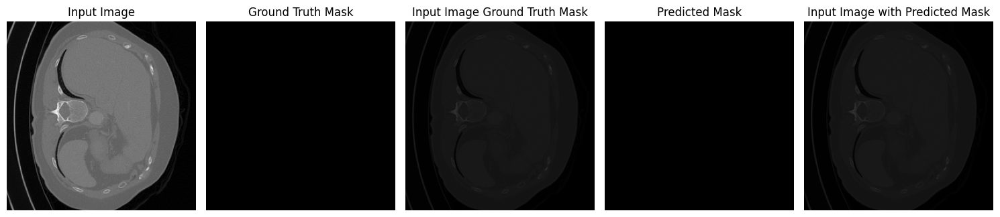

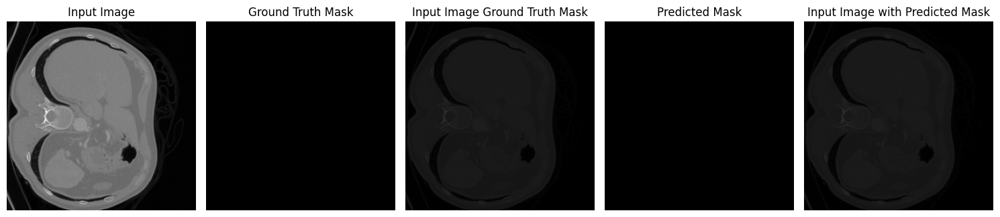

Epoch 92| Train_loss: 0.0805| Validate_loss: 0.5437| Val IOU: 0.3328| Val Best IOU 0.5209| Val Dice Coefficient 0.4714


Epoch 93/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


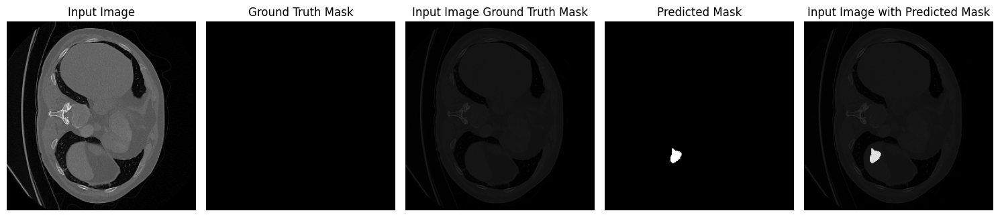

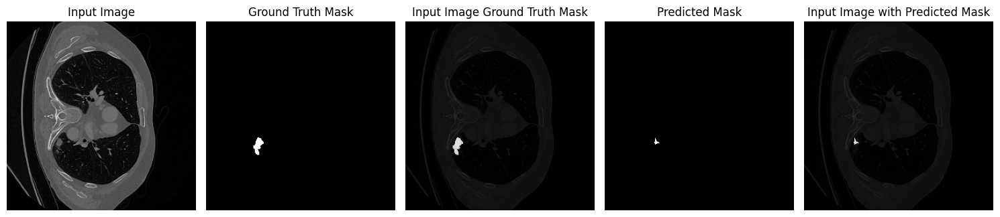

Epoch 93| Train_loss: 0.0789| Validate_loss: 0.5629| Val IOU: 0.3228| Val Best IOU 0.5209| Val Dice Coefficient 0.4546


Epoch 94/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


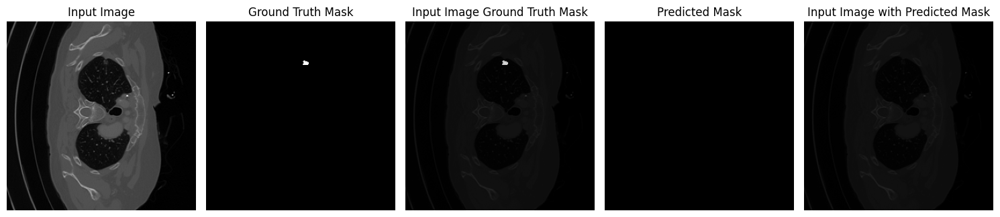

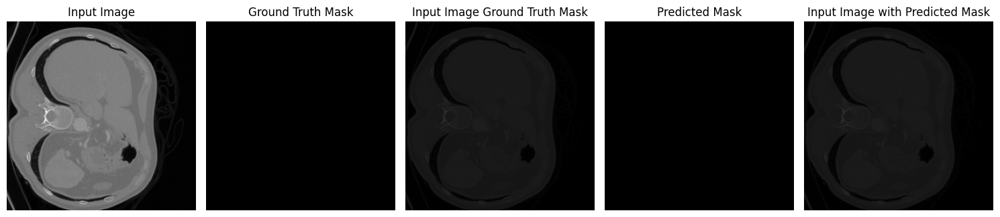

Epoch 94| Train_loss: 0.0821| Validate_loss: 0.5720| Val IOU: 0.3224| Val Best IOU 0.5209| Val Dice Coefficient 0.4459


Epoch 95/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


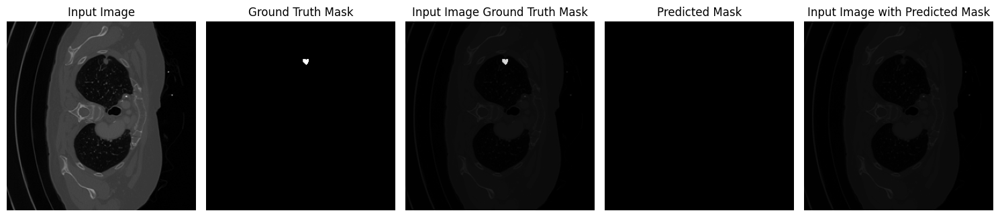

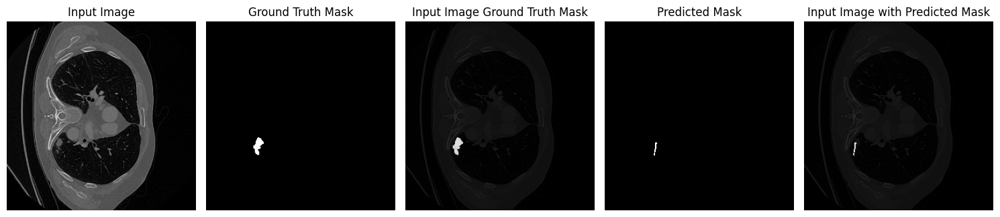

Epoch 95| Train_loss: 0.0770| Validate_loss: 0.5370| Val IOU: 0.3470| Val Best IOU 0.5209| Val Dice Coefficient 0.4765


Epoch 96/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


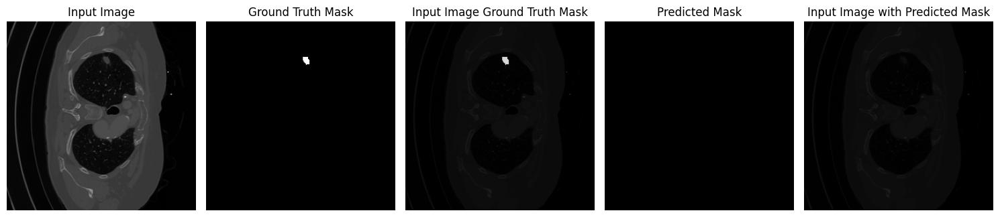

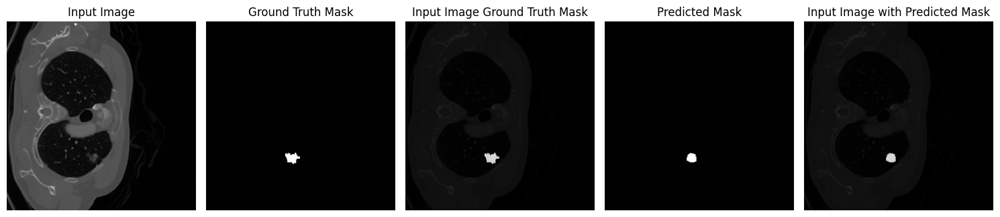

Epoch 96| Train_loss: 0.0808| Validate_loss: 0.5959| Val IOU: 0.3025| Val Best IOU 0.5209| Val Dice Coefficient 0.4243


Epoch 97/100: 100%|██████████| 458/458 [01:02<00:00,  7.36it/s]


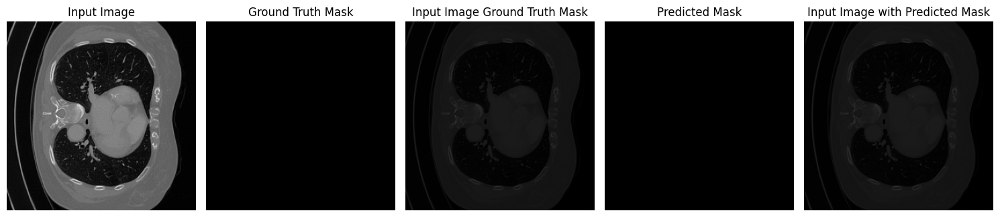

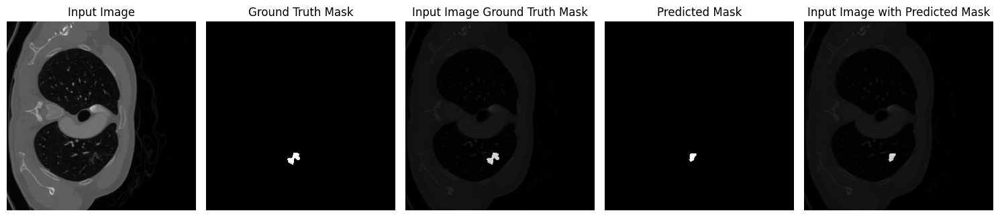

Epoch 97| Train_loss: 0.0786| Validate_loss: 0.5532| Val IOU: 0.3375| Val Best IOU 0.5209| Val Dice Coefficient 0.4632


Epoch 98/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


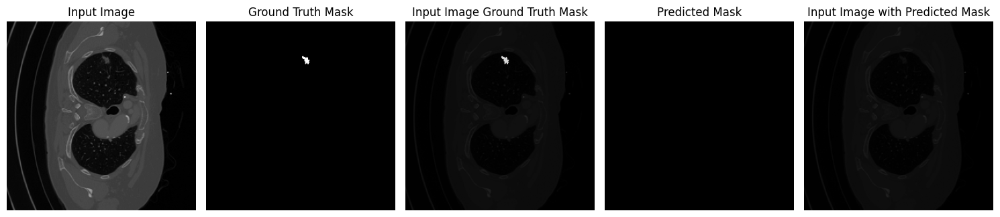

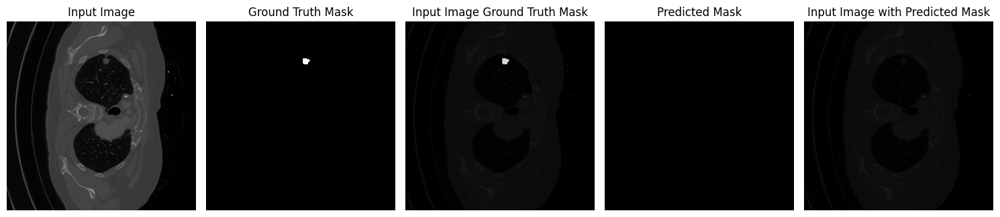

Epoch 98| Train_loss: 0.0785| Validate_loss: 0.4994| Val IOU: 0.3695| Val Best IOU 0.5209| Val Dice Coefficient 0.5168


Epoch 99/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


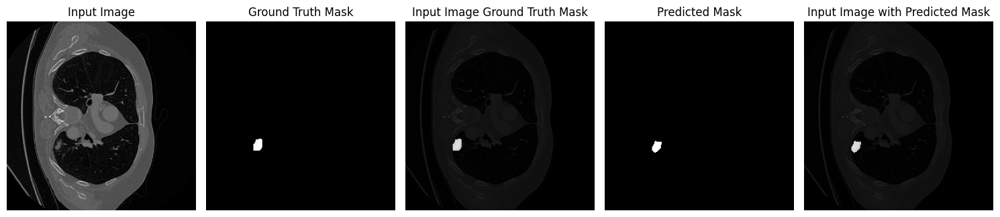

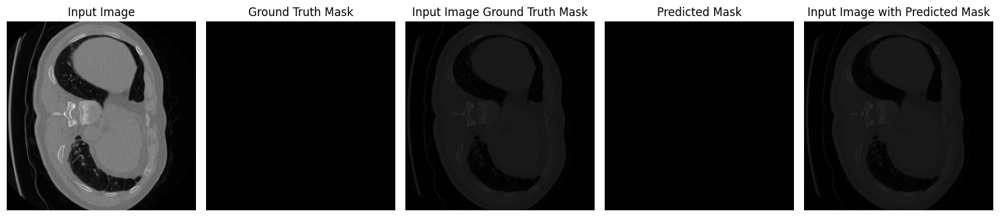

Epoch 99| Train_loss: 0.0733| Validate_loss: 0.5205| Val IOU: 0.3631| Val Best IOU 0.5209| Val Dice Coefficient 0.4947


Epoch 100/100: 100%|██████████| 458/458 [01:02<00:00,  7.35it/s]


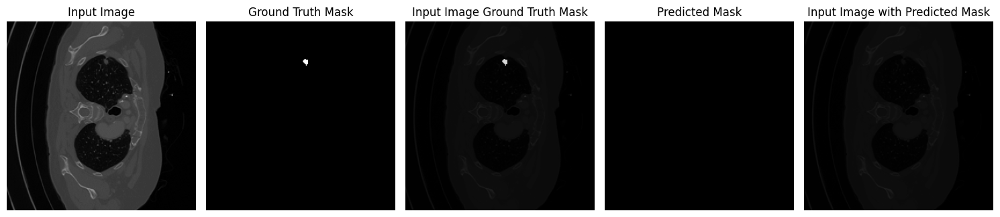

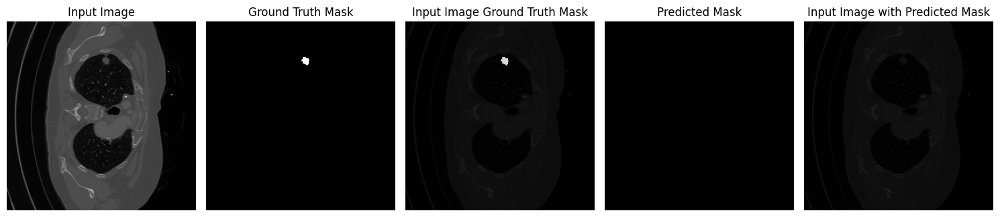

Epoch 100| Train_loss: 0.0834| Validate_loss: 0.5420| Val IOU: 0.3377| Val Best IOU 0.5209| Val Dice Coefficient 0.4714


In [30]:
total_train_loss = []
total_val_loss = []
best_iou = 0

for epoch in range(EPOCHS):    
    model.train()
    epoch_loss = 0
    for img , mask in tqdm(train_loader,desc=f'Epoch {epoch+1}/{EPOCHS}'):
        
        optimizer.zero_grad()
        img , mask = img.to(device) , mask.to(device)
        # print(img.size())
        
        # pred = model(img)
        
        # print(pred)
        pred = model(img)['out'] 

        loss = loss_fn(pred,mask)  
        
        loss.backward()
        
        norm = nn.utils.clip_grad_norm_(model.parameters(),1.0)
        
        optimizer.step()
        
        epoch_loss += loss.item()
    
    epoch_loss/=len(train_loader)
    val_loss,iou,dice = validate(model,loss_fn,val_loader,device)
    
    if iou > best_iou:
        print(f'Achieved Better IOU with {iou}, Than {best_iou}')
        best_iou = iou
        torch.save(model.state_dict(), os.path.join(model_dir,"fcn_resnet50_weights.pth"))
        
    total_train_loss.append(epoch_loss)
    total_val_loss.append(val_loss)
    
    print(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}")
    with open(log_file,'a') as f:
            f.write(f"Epoch {epoch+1}| Train_loss: {epoch_loss:.4f}| Validate_loss: {val_loss:.4f}| Val IOU: {iou:.4f}| Val Best IOU {best_iou:.4f}| Val Dice Coefficient {dice:.4f}\n")  

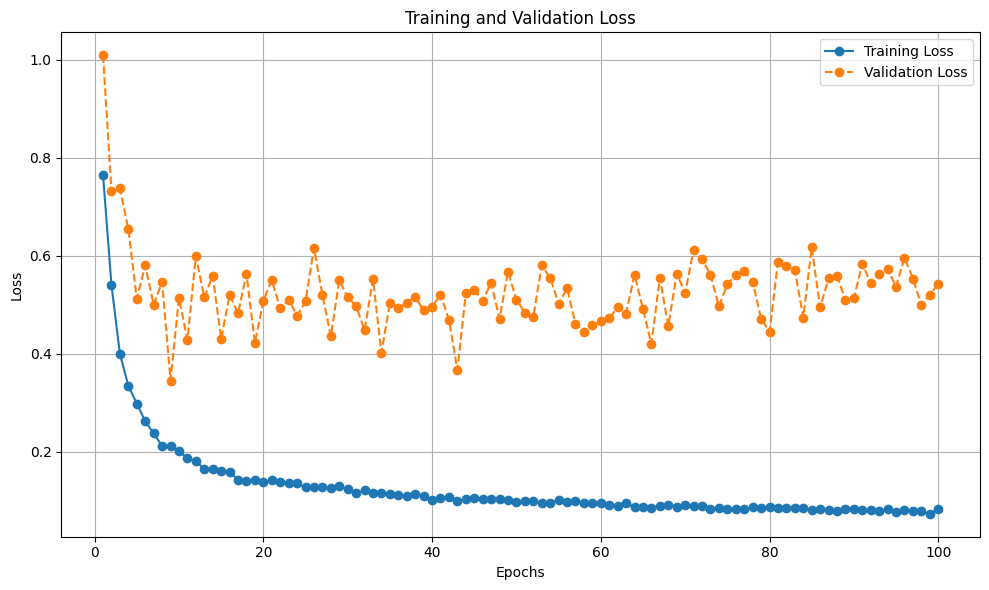

In [31]:
plt.figure(figsize=(10, 6))
epochs = range(1, len(total_train_loss) + 1)

# Plot training and validation loss
plt.plot(epochs, total_train_loss, label='Training Loss', marker='o', linestyle='-')
plt.plot(epochs, total_val_loss, label='Validation Loss', marker='o', linestyle='--')

# Add titles and labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.savefig("loss_plot.png")

# Show the plot
plt.tight_layout()
plt.show()